## HLS Product Validation and Comparison Notebook

### Introduction

This notebook provides a workflow for validating and comparing Harmonized Landsat and Sentinel-2 (HLS) satellite products. It is designed to evaluate differences between older and newer HLS versions through both visual and statistical analyses. The workflow includes steps for data loading, preprocessing, visualization, and quantitative assessment using selected test sites and temporal samples. By following this notebook, you can identify improvements, inconsistencies, or biases between HLS product versions and ensure the reliability of the updated datasets for downstream applications.

### Outline
1. **Data Preparation** – define inputs, select sites, and configure the working environment.
2. **Data Loading and Preprocessing** – access HLS products, apply quality filters, and extract required bands or indices.
3. **Visual Comparison** – generate RGB composites, side-by-side comparisons, and difference maps.
4. **Statistical Evaluation** – compute summary statistics and quantitative metrics for inter-product assessment.




### 1. Data Preparation
- Define data sources and input directories  
- List HLS products and versions being compared  
- Select test sites and time periods  
- Import the required Python libraries

Use one of the following options to install the required Python libraries before running the notebook.

In [2]:
# Method 1: Import using environment.yml 
mamba env create -f environment.yml


SyntaxError: invalid syntax (1308180256.py, line 2)

In [ ]:
# Method 2: directly install packages using mamba/conda 
mamba create -n lpdaac_vitals -c conda-forge --yes python=3.12 gdal fiona boto3 hvplot geoviews rioxarray rasterio jupyter geopandas earthaccess jupyter_bokeh h5py h5netcdf spectral scikit-image jupyterlab seaborn dask ray-default pystac-client odc-stac pyresample libgdal-hdf4 harmony-py


Next, activate the Python Environment that you just created.

In [ ]:
mamba activate lpdaac_vitals 

Now, import the libraries and packages 

In [11]:
import rasterio
import os
import matplotlib.pyplot as plt
import glob
import numpy as np
import matplotlib.image as mpimg
import matplotlib.colors as colors
from datetime import datetime
import pandas as pd
import seaborn as sns
import copy

%run -i ./module/plotting.ipynb
%run -i ./module/data_access.ipynb
%run -i ./module/algorithm.ipynb
%run -i ./module/ultilities.ipynb
%run -i ./module/fmask.ipynb
#This environment varialbe is necessary for anonymous s3 driver access to the bucket.
%env AWS_NO_SIGN_REQUEST=YES

from IPython import get_ipython
_ip = get_ipython()
if _ip is not None:
    if PLOT_MODE == "interactive":
        _ip.run_line_magic("matplotlib", "qt5")
    else:
        _ip.run_line_magic("matplotlib", "inline")


env: AWS_NO_SIGN_REQUEST=YES


In [ ]:
folders ='/home/jovyan/shared-public/recovered/hls-validation/sample_data/'

# Define a folder directory for pre-product (e.g., Fmask_v47)
# folder_pre =  '/home/jovyan/shared-public/recovered/hls-validation/sample_data/fmask4.7/'
folder_pre = 's3://hls-debug-output/Fmask4_outputs/Sentinel-2/'

# Define a folder directory for post-product (e.g., Fmask_v5)
#folder_post = '/home/jovyan/shared-public/recovered/hls-validation/sample_data/fmask5_May2025/'
folder_post = 's3://hls-debug-output/Fmask5_outputs/Sentinel-2/'

### 2. Data Loading and Preprocessing

- Load HLS scenes (e.g., HLSL30, HLSS30)  
- Apply cloud masking or quality filtering  
- Align datasets spatially and temporally  
- Extract relevant spectral bands or indices (e.g., NDVI, NIR)  

To read files from an S3 bucket anonymously in Python, you can use the boto3 library with the botocore.UNSIGNED configuration.

In [ ]:
bucket_name = 'hls-debug-output'
prefix_fmask5 = '/'.join(folder_post.split('/')[3:])
prefix_fmask4 = '/'.join(folder_pre.split('/')[3:])
files_s3_fmask5 = list_all_s3_files_anonymous(bucket_name, prefix=prefix_fmask5)
files_s3_fmask4 = list_all_s3_files_anonymous(bucket_name, prefix=prefix_fmask4)
len(files_s3_fmask4), len(files_s3_fmask5)

(2461, 854)

### 3. Visual Comparison
- Display sample RGB imagery and additional bands  
- Create side-by-side visualization of legacy and updated products  
- Generate difference maps to highlight pixel-level changes  

In [ ]:
# Get a list of unique granule/tile ID 
days = np.unique([i.split('.')[3] for i in files_s3_fmask5])

# get the percentage coverage of each fmask feature for each fmask version 
df_fmask_percentage = get_fmask_percentage_compare(files_s3_fmask5, files_s3_fmask4, days)

No matching for this granules between Fmask 4 and 5 for this mrgs ID on this date 2018196
No matching for this granules between Fmask 4 and 5 for this mrgs ID on this date 2018209
No matching for this granules between Fmask 4 and 5 for this mrgs ID on this date 2018219
No matching for this granules between Fmask 4 and 5 for this mrgs ID on this date 2018283
No matching for this granules between Fmask 4 and 5 for this mrgs ID on this date 2018319
No matching for this granules between Fmask 4 and 5 for this mrgs ID on this date 2018346
No matching for this granules between Fmask 4 and 5 for this mrgs ID on this date 2018351
No matching for this granules between Fmask 4 and 5 for this mrgs ID on this date 2018355
No matching for this granules between Fmask 4 and 5 for this mrgs ID on this date 2018360
No matching for this granules between Fmask 4 and 5 for this mrgs ID on this date 2019002
No matching for this granules between Fmask 4 and 5 for this mrgs ID on this date 2019004
No matchin

Performing the plotting for a certain MRGS ID:

https://github.com/NASA-IMPACT/hls_development/issues/358

As defined by Qiang for testing: 

- 31UDQ Urban, cropland;

- 10UEV Urban, mountain with permanent snow;

- 11SLT Urban, mountains;

- 42QWM Coast, bright sand

We select some indivual case and plot True color composite, Cirrus, Fmask4 and 5, and statistical comparision

In [ ]:
mrgs_id_target = '31UDQ'

# get list of files for fmask 5 and fmask 4 for this id

files_fmask5_test, files_fmask4_test, day_uniques, day_uniques_julian = filter_fmask_files(
    files_s3_fmask5, files_s3_fmask4, mrgs_id_target, to_julian_date
)

Important:

To have a interactive interface for comparision, it is suggested to use 'qt5' on notebook by running this following cell: %matplotlib qt

In [ ]:
%matplotlib inline

In [ ]:
# Looping over each unique day to plot each granule for comparision 
for day in day_uniques[::2]:
    
    fig, axes = plt.subplots(figsize=(12.97, 10.44),
                             #sharex=True,
                             #sharey=True,
                             ncols=3,
                             nrows=3
                             )
    
    axes = [i for ax in axes for i in ax]

    # Part 1: Plot RGB, Fmask4, Fmask5, and Cirrus bands 
    raster_list = list()
    for i in range(4):
        
        fmask_version = get_fmask_info(i=i)['fmask_version']
        title = get_fmask_info(i=i)['title']
  
        ax = axes[i]
        
        ax.set_title(title)

        # Get file path based on fmask version and types
        file_path = select_fmask_files(fmask_version=fmask_version,
                                    day=day,
                                    files_fmask4_test=files_fmask4_test,
                                    files_fmask5_test=files_fmask5_test,
                                    day_uniques=day_uniques,
                                    day_uniques_julian=day_uniques_julian
                                )
        # get the reference file of fmask 4 for spatial extent reference
        fmask4_ref = select_fmask_files(fmask_version='fmask4.7',
                                    day=day,
                                    files_fmask4_test=files_fmask4_test,
                                    files_fmask5_test=files_fmask5_test,
                                    day_uniques=day_uniques,
                                    day_uniques_julian=day_uniques_julian
                                )
        
        # Read the file path as raster
        raster = read_raster_or_rgb(file_path, bucket_name, read_true_color_from_files, fmask4_ref)

        
        raster_list.append(raster)


        if i == 0:
            # plot true color composite RGB
            # Assuming rgb_image is your input RGB array
            # stretched_rgb = stretch_rgb(raster)

            # Change: apply log stretching instead of linear stretching
            stretched_rgb = log_stretching_reflectance_optimized(raster)
    
            ax.imshow(stretched_rgb)
            ax.set_title("RGB stretched reference", fontsize=12)

        elif i == 3:
            # plot grey-scale cirrus band
            plot_cirrus_band(ax, raster)
      

        else:

            cax_fmask = plot_fmask_raster(ax, raster, i=i, fig=fig, show_colorbar=(i == 2))
            ax.set_title(f"Fmask "+fmask_version, fontsize=12)
        
                
    # Part 2: plot histogram and actual images to show differences in cloudy and cloud maskpixels between two versions
    # Fmask 47 - Fmask 5
    cax_fmask_diff = plot_fmask_diff(raster_list, axes, fig)

    
    
    # add a barchart show percentage
    plot_fmask_percentage_by_day(day, df_fmask_percentage, axes)
    
    day_convert = datetime.strptime(day, '%Y%j').strftime('%Y-%m-%d')

    # Part 3: final formating 
    fig.suptitle('Fmask compare '+day_convert + 'for tile ID'+mrgs_id_target,
                 size=18)
    
    customize_axes_layout(axes, cax_fmask, cax_fmask_diff, i, fig)


    fig.savefig('figures/'+'Fmask_compare_'+day+'_'+mrgs_id_target+
                '.png',dpi=300)
    

### 4. Statistical Evaluation:
- Compute descriptive statistics (mean, std, RMSE, correlation)  
- Pixel-wise comparison across products  
- Time-series consistency analysis (if multi-date data available)  
- Summary tables and plots

Figure saved to fmask_comparison.png


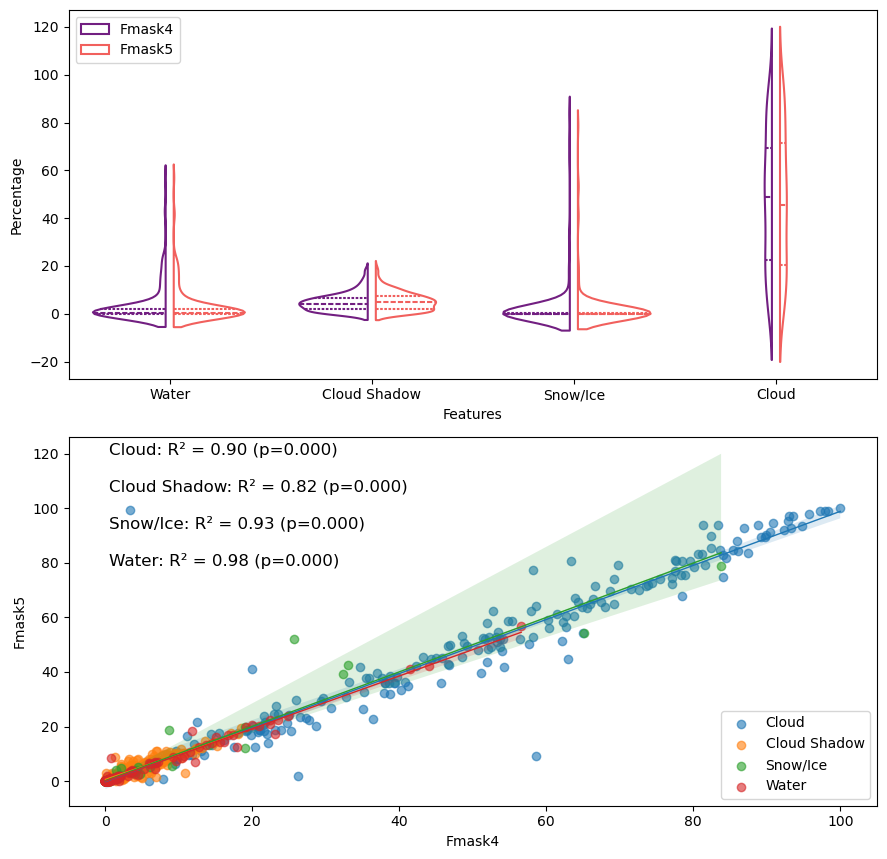

In [ ]:
#Example usage with sample data structure
#df_fmask_percentage should have columns:
# - 'Features': e.g., 'Cloud', 'Cloud Shadow', 'Water', 'Snow'
# - 'Percentage': Cloud coverage percentage
# - 'fmask_version': 'Fmask4' or 'Fmask5'
# - 'Date': Date string
# - 'mrgs_id': MGRS tile ID

fig, axes = plot_fmask_comparison_stats(
    df_fmask_percentage,
    fmask4_col='Fmask4',
    fmask5_col='Fmask5',
    save_path='fmask_comparison.png'
)

### 5. Time Series Analysis - Comparision
We have some times for time series comparsion of Fmask 4.7 vs 5.0 in HLS products: 

- 31UDQ Urban, cropland;
- 10UEV Urban, mountain with permanent snow;
- 11SLT Urban, mountains;
- 42QWM Coast, bright sand


There are common issues in cloud detection. The purpose of this assessment is to verify whether any improvements from Fmask 5.0 that addresses these challenges from Fmask 4.7: 

1. Cloud Commision over bright surface e.g., Urban (Building) footprints
   Fmask 4.7 still faces issues with cloud commission over bright surfaces e.g., building, roofs. To verify whether Fmask 5. improves the detection of clouds over buildings, cloud coverage is estimated over a large sample of urban building footprints over multiple years. If the cloud comission in Fmask 5.0 has been improved, we should expect to see less cloud coverage over time

Below is an example snapshot of cloud commission over bright surface in Fmask 4.7 and how different Fmask 5.0 generally looks like. 

2. Cloud shawdow Omission over dark surfaces e.g., water (reference: https://github.com/qsly09/fmask5/wiki/Cloud-Shadow-Detection)

**5.1 Configuration**
- Define S3 bucket paths for Fmask 4.7 and 5.0 products
- Set time period for analysis (e.g., 2018-2024)
- Define MGRS tile IDs for test sites
- Set AWS configuration for anonymous S3 access

In [ ]:
# Example usage: load and analyze Fmask time-series data

mrgs_id_target = '10UEV'
sat_id = 'S30'
s3_Fmask47 = 's3://hls-debug-output/Fmask4_outputs/TS/'+sat_id+'/'+mrgs_id_target+'/'
s3_Fmask5 = 's3://hls-debug-output/Fmask5_outputs/TS/'+sat_id+'/'+mrgs_id_target+'/'

**5.2 HLS Data Preparation**
- List available Fmask 4.7 products from S3
- List available Fmask 5.0 products from S3
- Match products by date and MGRS tile ID
- Load the data as data array with time dimensions


In [4]:


# Load Fmask 4.7 and 5.0 time-series data
fmask_pair = load_fmask_pair(
    mrgs_id_target,
    bucket='hls-debug-output',
    fmask4_files=s3_Fmask47,   # S3 link to Fmask 4.7 outputs
    fmask5_files=s3_Fmask5,    # S3 link to Fmask 5.0 outputs
)


fmask4_data = fmask_pair["fmask4"]
fmask5_data = fmask_pair["fmask5"]

# Filter RGB bands to keep only time steps with sufficient valid pixels
fmask4_red_raw = fmask_pair["fmask4_red"]
fmask4_green_raw = fmask_pair["fmask4_green"]
fmask4_blue_raw = fmask_pair["fmask4_blue"]

# Replace -9999 (no data value) with NaN for all RGB bands
if fmask4_red_raw is not None:
    fmask4_red_raw = fmask4_red_raw.where(fmask4_red_raw != -9999, np.nan)
if fmask4_green_raw is not None:
    fmask4_green_raw = fmask4_green_raw.where(fmask4_green_raw != -9999, np.nan)
if fmask4_blue_raw is not None:
    fmask4_blue_raw = fmask4_blue_raw.where(fmask4_blue_raw != -9999, np.nan)


# Basic information
print(f"Loaded MRGS ID: {mrgs_id_target}")
print(f"Fmask 4.7 available: {fmask4_data is not None}")
print(f"Fmask 5.0 available: {fmask5_data is not None}")

Matched 148 common time steps out of 148 (Fmask 4.7) and 216 (Fmask 5.0) total time steps

Processing Red band...
  Red band: Limiting to first 40 files out of 148 total
Loading Red band: 40 files total
  Red band progress: 1/40 (2.5%) - Loaded: 1, Skipped: 0, Remaining: 39
  Red band progress: 2/40 (5.0%) - Loaded: 2, Skipped: 0, Remaining: 38
  Red band progress: 3/40 (7.5%) - Loaded: 3, Skipped: 0, Remaining: 37
  Red band progress: 4/40 (10.0%) - Loaded: 4, Skipped: 0, Remaining: 36
  Red band progress: 5/40 (12.5%) - Loaded: 5, Skipped: 0, Remaining: 35
  Red band progress: 6/40 (15.0%) - Loaded: 6, Skipped: 0, Remaining: 34
  Red band progress: 7/40 (17.5%) - Loaded: 7, Skipped: 0, Remaining: 33
  Red band progress: 8/40 (20.0%) - Loaded: 8, Skipped: 0, Remaining: 32
  Red band progress: 9/40 (22.5%) - Loaded: 9, Skipped: 0, Remaining: 31
  Red band progress: 10/40 (25.0%) - Loaded: 10, Skipped: 0, Remaining: 30
  Red band progress: 11/40 (27.5%) - Loaded: 11, Skipped: 0, Remaini

**5.2 Cloud Frequency Calculation Per Pixel**

Defines cloud frequency per pixel as the proportion of time steps where a pixel is classified as cloud (value = 4) relative to valid observations.

- Load time-series data using load_fmask_pair()
- Calculate cloud frequency per pixel (count cloud occurrences / valid observations)
- Implementation using xarray operations
- Output generation (frequency maps, statistics, difference maps)


Cloud Coverage Comparison (Fmask 4.7 vs 5.0)
Time: 2024-01-07 00:00:00
  Fmask 4.7 cloud coverage: 70.05%
  Fmask 5.0 cloud coverage: 68.66%
  Difference: -1.39%

Time: 2024-01-10 00:00:00
  Fmask 4.7 cloud coverage: 93.11%
  Fmask 5.0 cloud coverage: 96.07%
  Difference: 2.96%

Time: 2024-01-12 00:00:00
  Fmask 4.7 cloud coverage: 80.82%
  Fmask 5.0 cloud coverage: 53.13%
  Difference: -27.69%

Time: 2024-01-13 00:00:00
  Fmask 4.7 cloud coverage: 99.56%
  Fmask 5.0 cloud coverage: 99.51%
  Difference: -0.05%

Time: 2024-01-15 00:00:00
  Fmask 4.7 cloud coverage: 96.41%
  Fmask 5.0 cloud coverage: 96.85%
  Difference: 0.45%

Time: 2024-01-25 00:00:00
  Fmask 4.7 cloud coverage: 96.39%
  Fmask 5.0 cloud coverage: 100.78%
  Difference: 4.39%

Time: 2024-01-28 00:00:00
  Fmask 4.7 cloud coverage: 99.92%
  Fmask 5.0 cloud coverage: 99.91%
  Difference: -0.01%

Time: 2024-02-04 00:00:00
  Fmask 4.7 cloud coverage: 93.76%
  Fmask 5.0 cloud coverage: 94.33%
  Difference: 0.58%

Time: 2024-02

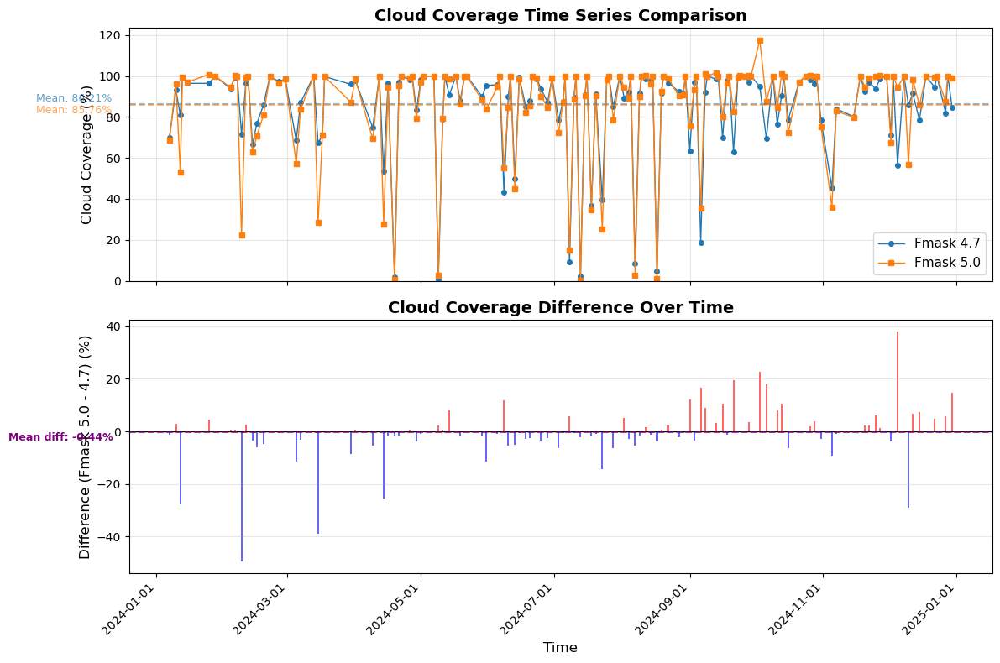


Summary Statistics:
  Mean Fmask 4.7 coverage: 86.21%
  Mean Fmask 5.0 coverage: 85.76%
  Mean difference: -0.44%
  Total time steps: 148


In [5]:
# Example usage: Calculate cloud coverage for each time step
if fmask4_data is not None and fmask5_data is not None:
    cloud_coverage_df = calculate_cloud_coverage_timeseries(
        fmask4_data, 
        fmask5_data, 
        verbose=True,
        mask_value=4)  # 4 for cloud
    
    # Visualize cloud coverage time series
    if cloud_coverage_df is not None:
        fig, axes = plot_cloud_coverage_timeseries(
            cloud_coverage_df,
            linewidth=1,  # Thin lines
            show_stats=True
        )


**5.3. Maps of Cloud Frequency over Time**

- Visualization features (side-by-side comparison, difference maps, color-coding)
- Export options (GeoTIFF, PNG, NetCDF)
- Use cases and applications


In [9]:
# Calculate cloud frequency per pixel for each Fmask version
if fmask4_data is not None and fmask5_data is not None:
    print("Calculating cloud frequency per pixel...")
    fmask4_frequency = calculate_cloud_frequency_per_pixel(fmask4_data, mask_value=4)  # 4 for cloud
    fmask5_frequency = calculate_cloud_frequency_per_pixel(fmask5_data, mask_value=4)  # 4 for cloud
    
    print(f"Fmask 4.7 frequency map shape: {fmask4_frequency.shape}")
    print(f"Fmask 5.0 frequency map shape: {fmask5_frequency.shape}")
    print(f"Fmask 4.7 frequency range: {fmask4_frequency.min().values:.3f} to {fmask4_frequency.max().values:.3f}")
    print(f"Fmask 5.0 frequency range: {fmask5_frequency.min().values:.3f} to {fmask5_frequency.max().values:.3f}")
    


Calculating cloud frequency per pixel...
Fmask 4.7 frequency map shape: (3660, 3660)
Fmask 5.0 frequency map shape: (3660, 3660)
Fmask 4.7 frequency range: 0.604 to 1.000
Fmask 5.0 frequency range: 0.531 to 1.000


Filtered time steps: 40 -> 14 (kept 35.0% with >= 60% valid pixels)
Filtered time steps: 40 -> 14 (kept 35.0% with >= 60% valid pixels)
Filtered time steps: 40 -> 14 (kept 35.0% with >= 60% valid pixels)


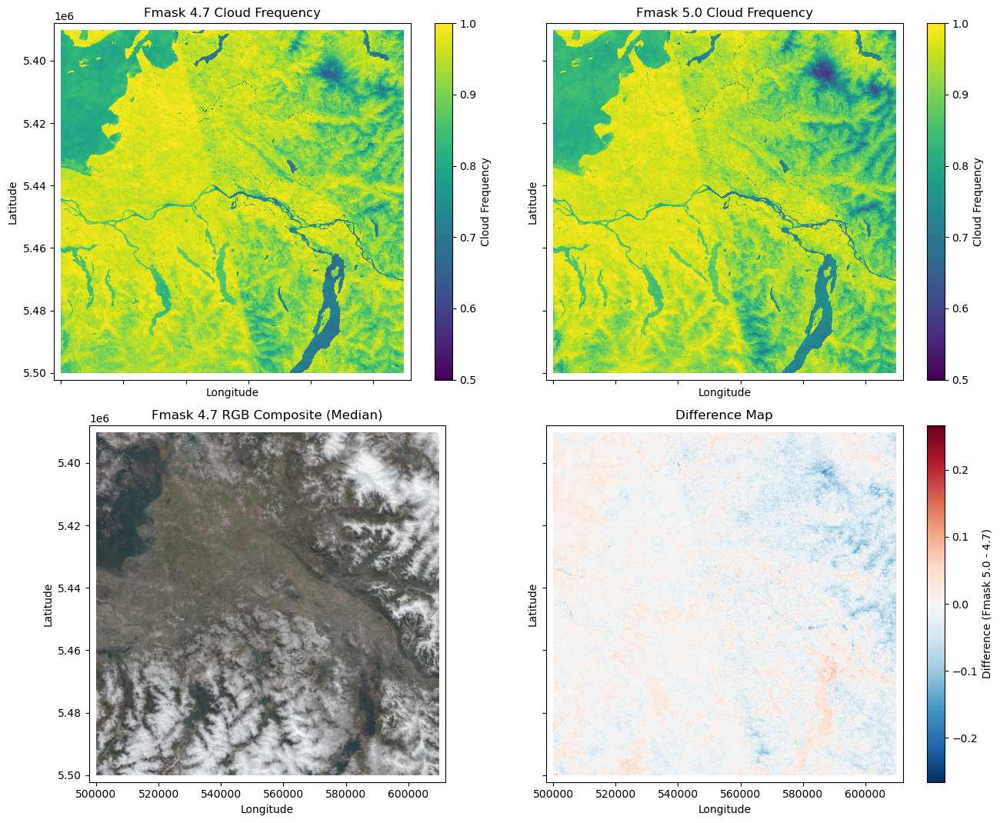

In [16]:
# Step 3: Visualize with shared zoom
# With RGB composite
# Use RGB data for visualization
# Check if all RGB bands are available
if all([fmask4_red_raw is not None, fmask4_green_raw is not None, fmask4_blue_raw    is not None]):
    
    # Apply filtering to each RGB band
    if fmask4_red_raw is not None:
        fmask4_red = filter_valid_time_steps(fmask4_red_raw, min_valid_ratio=0.6)
    else:
        fmask4_red = None

    if fmask4_green_raw is not None:
        fmask4_green = filter_valid_time_steps(fmask4_green_raw, min_valid_ratio=0.6)
    else:
        fmask4_green = None

    if fmask4_blue_raw is not None:
        fmask4_blue = filter_valid_time_steps(fmask4_blue_raw, min_valid_ratio=0.6)
    else:
        fmask4_blue = None

    fmask4_red_median = fmask4_red.median(dim='time')
    fmask4_green_median = fmask4_green.median(dim='time')
    fmask4_blue_median = fmask4_blue.median(dim='time')

    fig, axes = visualize_and_export_cloud_frequency(
        fmask4_freq=fmask4_frequency,
        fmask5_freq=fmask5_frequency,
        fmask4_red=fmask4_red_median,
        fmask4_green=fmask4_green_median,
        fmask4_blue=fmask4_blue_median,
        vmin=0.5,
        vmax=1.0,
        mask_type="cloud")  # "cloud" for cloud analysis
else:
    # Visualize without RGB composite
    fig, axes = visualize_and_export_cloud_frequency(
        fmask4_freq=fmask4_frequency,
        fmask5_freq=fmask5_frequency,
        mask_type="cloud")  # "cloud" for cloud analysis

### 6. Batch Time Series Comparison for Multiple MRGS IDs
This section performs the same batch time series comparison workflow as Section 6, but focuses on **cloud mask detection** instead of cloud detection. Cloud shadow has a unique code value of **4** in the Fmask classification scheme (compared to **4** for clouds).

**Note:** This section uses the same consolidated functions as Section 6, but with `mask_value=4` to analyze cloud shadow instead of cloud. The functions `calculate_cloud_frequency_per_pixel`, `calculate_cloud_coverage_timeseries`, `visualize_and_export_cloud_frequency`, and `batch_time_series_comparison` all accept a `mask_value` parameter to specify which mask type to analyze.

The workflow includes:
- Calculating cloud shadow frequency per pixel for Fmask 4.7 and 5.0
- Generating time series plots of cloud shadow coverage over time
- Creating 2x2 panel visualizations comparing cloud shadow detection between versions
- Computing difference maps to highlight areas where cloud shadow detection differs


Batch Time Series Comparison
Processing 6 MRGS IDs: ['31UDQ', '11SLT', '42QWM', '11SPS', '18SUJ', '18TWL']


Processing MRGS ID 1/6: 31UDQ

[Step 1] Loading Fmask data for 31UDQ...
  Fmask 4.7 path: s3://hls-debug-output/Fmask4_outputs/TS/S30/31UDQ/
  Fmask 5.0 path: s3://hls-debug-output/Fmask5_outputs/TS/S30/31UDQ/

Loading Fmask data for MRGS ID: 31UDQ
Fmask 4.7: Found 97 matching files in bucket 'hls-debug-output'
  Sample files (first 3):
    - Fmask4_outputs/TS/S30/31UDQ/HLS.S30.T31UDQ.2024003T110441.v2.0.Fmask.tif
    - Fmask4_outputs/TS/S30/31UDQ/HLS.S30.T31UDQ.2024005T105339.v2.0.Fmask.tif
    - Fmask4_outputs/TS/S30/31UDQ/HLS.S30.T31UDQ.2024008T110339.v2.0.Fmask.tif
Fmask 5.0: Found 145 matching files in bucket 'hls-debug-output'
  Sample files (first 3):
    - Fmask5_outputs/TS/S30/31UDQ/HLS.S30.T31UDQ.2024003.1.toa.Fmask.tif
    - Fmask5_outputs/TS/S30/31UDQ/HLS.S30.T31UDQ.2024005.1.toa.Fmask.tif
    - Fmask5_outputs/TS/S30/31UDQ/HLS.S30.T31UDQ.2024008.1.toa.Fmask.tif

Matc

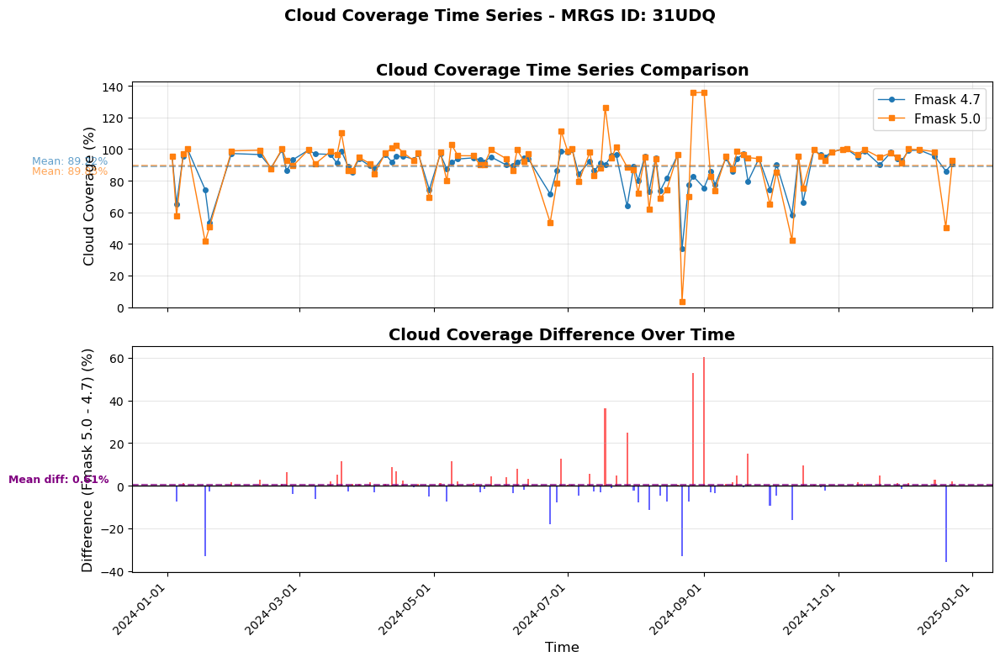

  ✓ Cloud coverage time series plotted (97 time steps)

[Step 4] Creating visualization for 31UDQ...


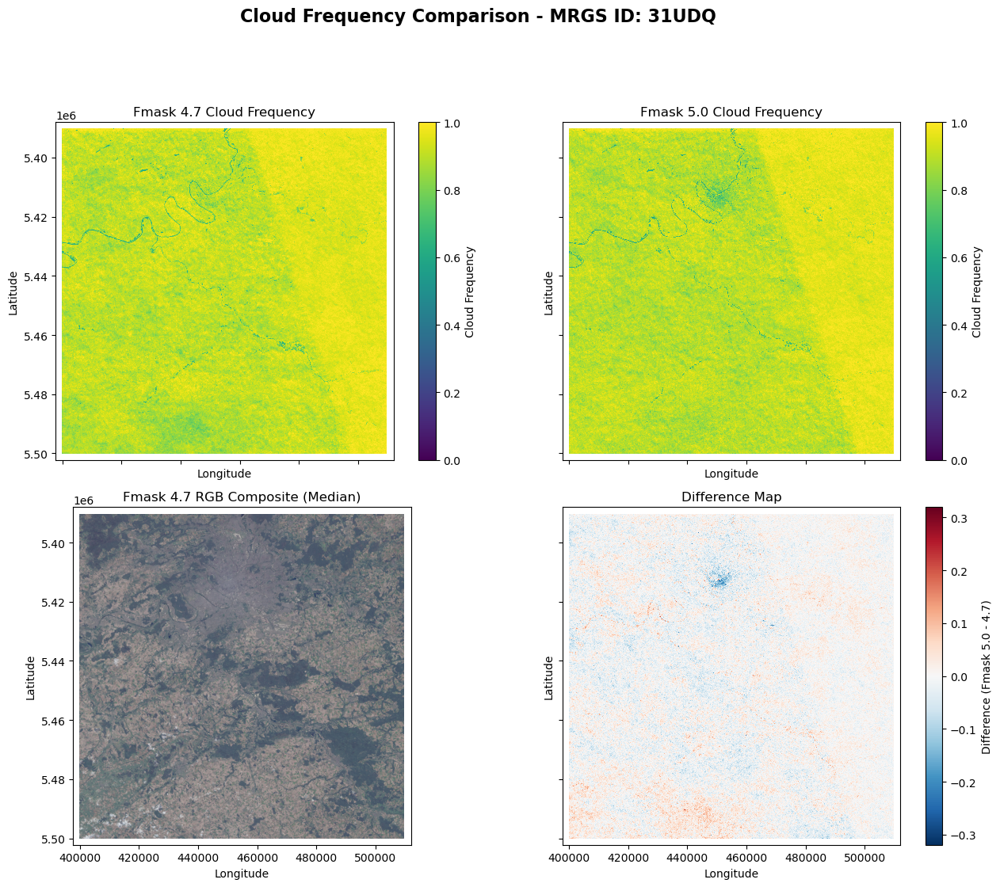

  ✓ Completed processing 31UDQ

Processing MRGS ID 2/6: 11SLT

[Step 1] Loading Fmask data for 11SLT...
  Fmask 4.7 path: s3://hls-debug-output/Fmask4_outputs/TS/S30/11SLT/
  Fmask 5.0 path: s3://hls-debug-output/Fmask5_outputs/TS/S30/11SLT/

Loading Fmask data for MRGS ID: 11SLT
Fmask 4.7: Found 133 matching files in bucket 'hls-debug-output'
  Sample files (first 3):
    - Fmask4_outputs/TS/S30/11SLT/HLS.S30.T11SLT.2024003T183749.v2.0.Fmask.tif
    - Fmask4_outputs/TS/S30/11SLT/HLS.S30.T11SLT.2024006T184749.v2.0.Fmask.tif
    - Fmask4_outputs/TS/S30/11SLT/HLS.S30.T11SLT.2024008T183741.v2.0.Fmask.tif
Fmask 5.0: Found 141 matching files in bucket 'hls-debug-output'
  Sample files (first 3):
    - Fmask5_outputs/TS/S30/11SLT/HLS.S30.T11SLT.2024001.1.toa.Fmask.tif
    - Fmask5_outputs/TS/S30/11SLT/HLS.S30.T11SLT.2024003.1.toa.Fmask.tif
    - Fmask5_outputs/TS/S30/11SLT/HLS.S30.T11SLT.2024006.1.toa.Fmask.tif

Matched 133 common time steps out of 133 (Fmask 4.7) and 141 (Fmask 5.0) total t

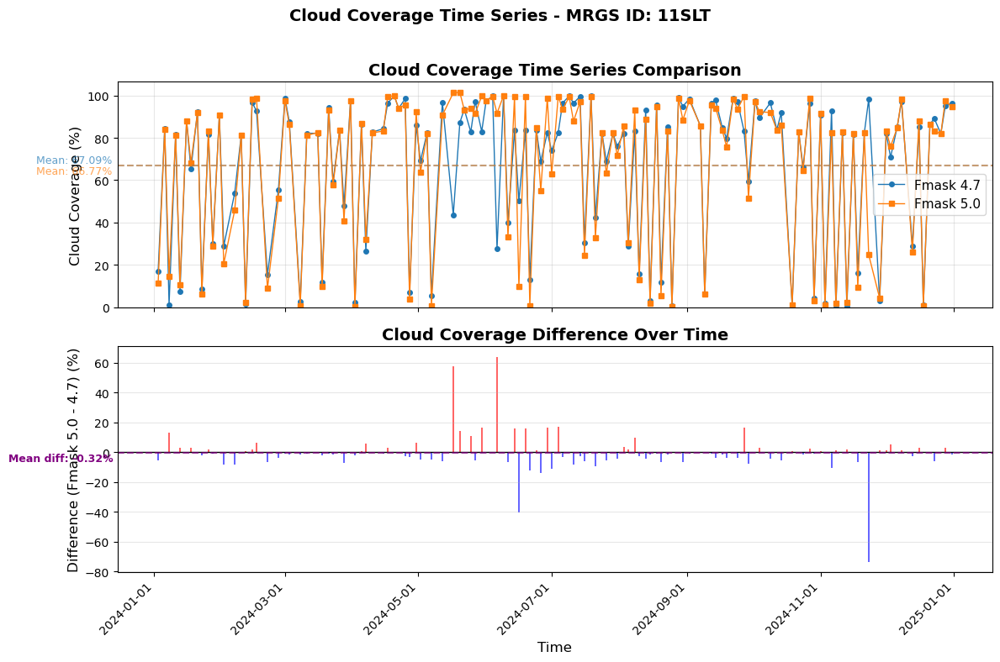

  ✓ Cloud coverage time series plotted (133 time steps)

[Step 4] Creating visualization for 11SLT...


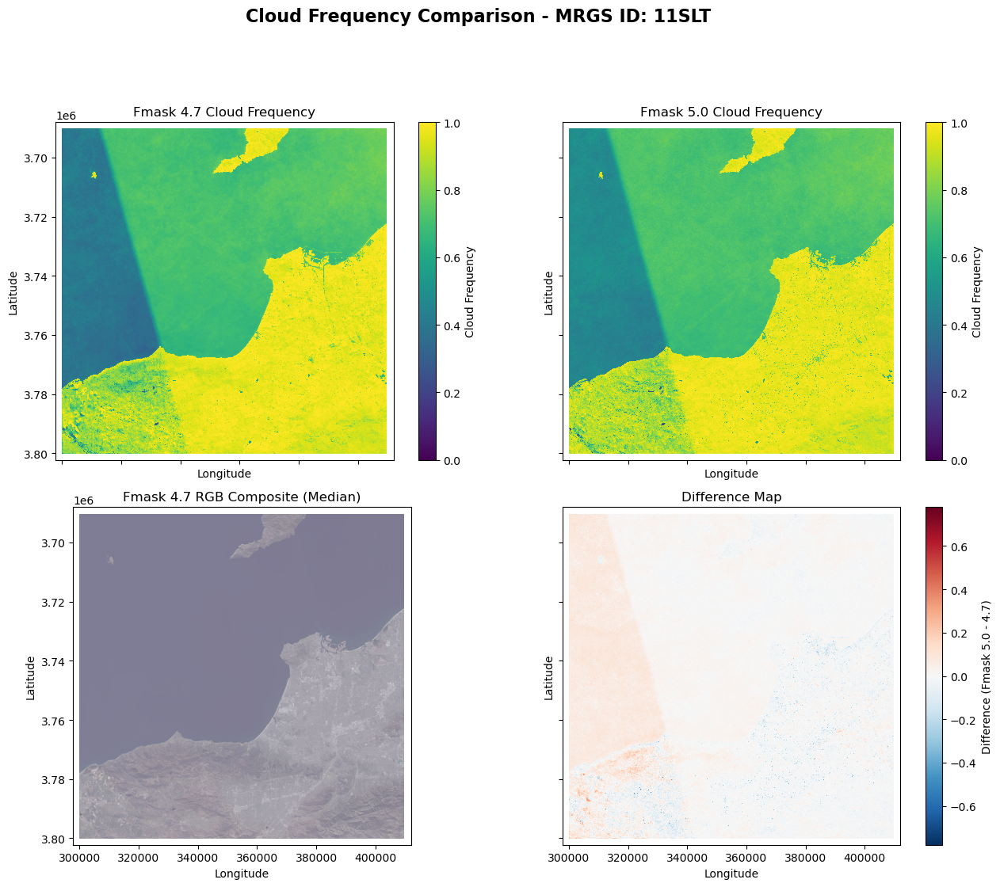

  ✓ Completed processing 11SLT

Processing MRGS ID 3/6: 42QWM

[Step 1] Loading Fmask data for 42QWM...
  Fmask 4.7 path: s3://hls-debug-output/Fmask4_outputs/TS/S30/42QWM/
  Fmask 5.0 path: s3://hls-debug-output/Fmask5_outputs/TS/S30/42QWM/

Loading Fmask data for MRGS ID: 42QWM
Fmask 4.7: Found 132 matching files in bucket 'hls-debug-output'
  Sample files (first 3):
    - Fmask4_outputs/TS/S30/42QWM/HLS.S30.T42QWM.2024003T060241.v2.0.Fmask.tif
    - Fmask4_outputs/TS/S30/42QWM/HLS.S30.T42QWM.2024005T055229.v2.0.Fmask.tif
    - Fmask4_outputs/TS/S30/42QWM/HLS.S30.T42QWM.2024008T060229.v2.0.Fmask.tif
Fmask 5.0: Found 142 matching files in bucket 'hls-debug-output'
  Sample files (first 3):
    - Fmask5_outputs/TS/S30/42QWM/HLS.S30.T42QWM.2024003.1.toa.Fmask.tif
    - Fmask5_outputs/TS/S30/42QWM/HLS.S30.T42QWM.2024005.1.toa.Fmask.tif
    - Fmask5_outputs/TS/S30/42QWM/HLS.S30.T42QWM.2024008.1.toa.Fmask.tif

Matched 132 common time steps out of 132 (Fmask 4.7) and 142 (Fmask 5.0) total t

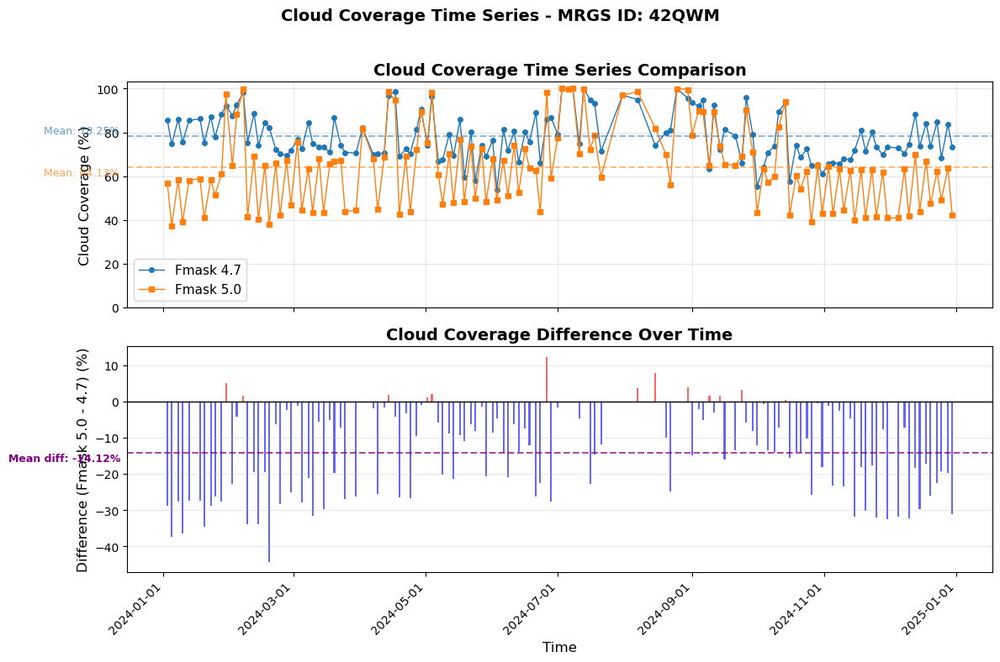

  ✓ Cloud coverage time series plotted (132 time steps)

[Step 4] Creating visualization for 42QWM...


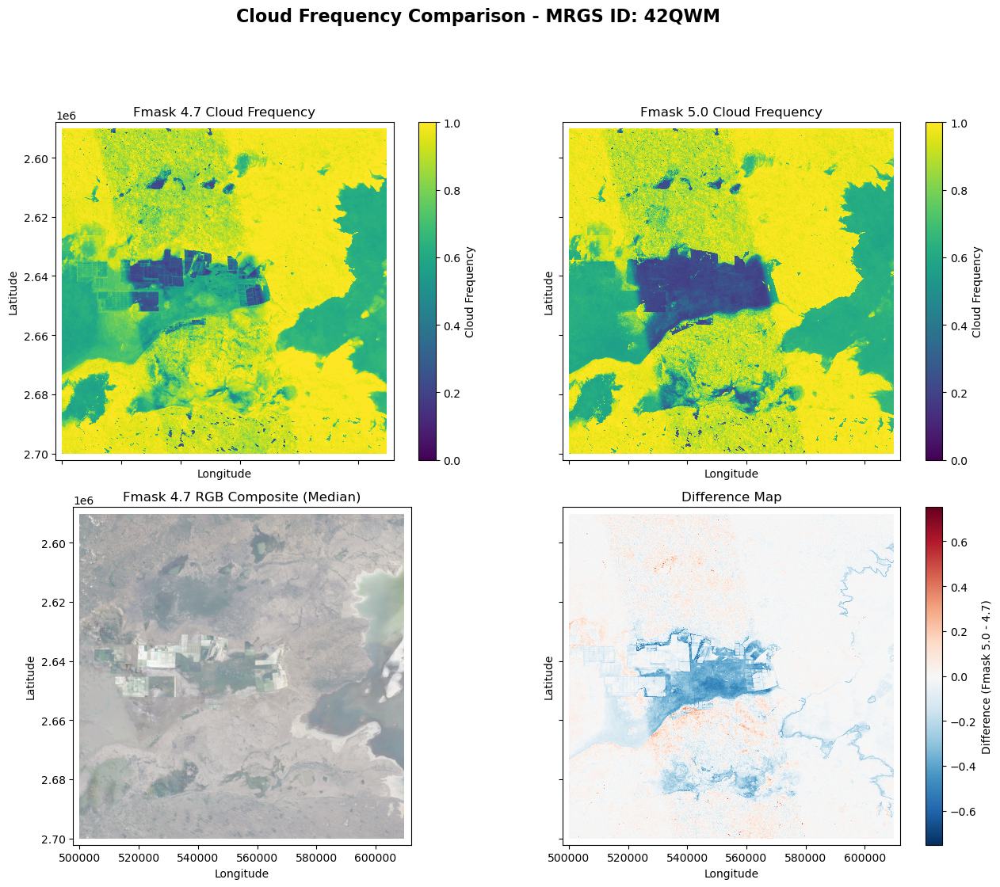

  ✓ Completed processing 42QWM

Processing MRGS ID 4/6: 11SPS

[Step 1] Loading Fmask data for 11SPS...
  Fmask 4.7 path: s3://hls-debug-output/Fmask4_outputs/TS/S30/11SPS/
  Fmask 5.0 path: s3://hls-debug-output/Fmask5_outputs/TS/S30/11SPS/

Loading Fmask data for MRGS ID: 11SPS
Fmask 4.7: Found 121 matching files in bucket 'hls-debug-output'
  Sample files (first 3):
    - Fmask4_outputs/TS/S30/11SPS/HLS.S30.T11SPS.2024005T182741.v2.0.Fmask.tif
    - Fmask4_outputs/TS/S30/11SPS/HLS.S30.T11SPS.2024007T181739.v2.0.Fmask.tif
    - Fmask4_outputs/TS/S30/11SPS/HLS.S30.T11SPS.2024010T182729.v2.0.Fmask.tif
Fmask 5.0: Found 130 matching files in bucket 'hls-debug-output'
  Sample files (first 3):
    - Fmask5_outputs/TS/S30/11SPS/HLS.S30.T11SPS.2024005.1.toa.Fmask.tif
    - Fmask5_outputs/TS/S30/11SPS/HLS.S30.T11SPS.2024007.1.toa.Fmask.tif
    - Fmask5_outputs/TS/S30/11SPS/HLS.S30.T11SPS.2024010.1.toa.Fmask.tif

Matched 121 common time steps out of 121 (Fmask 4.7) and 130 (Fmask 5.0) total t

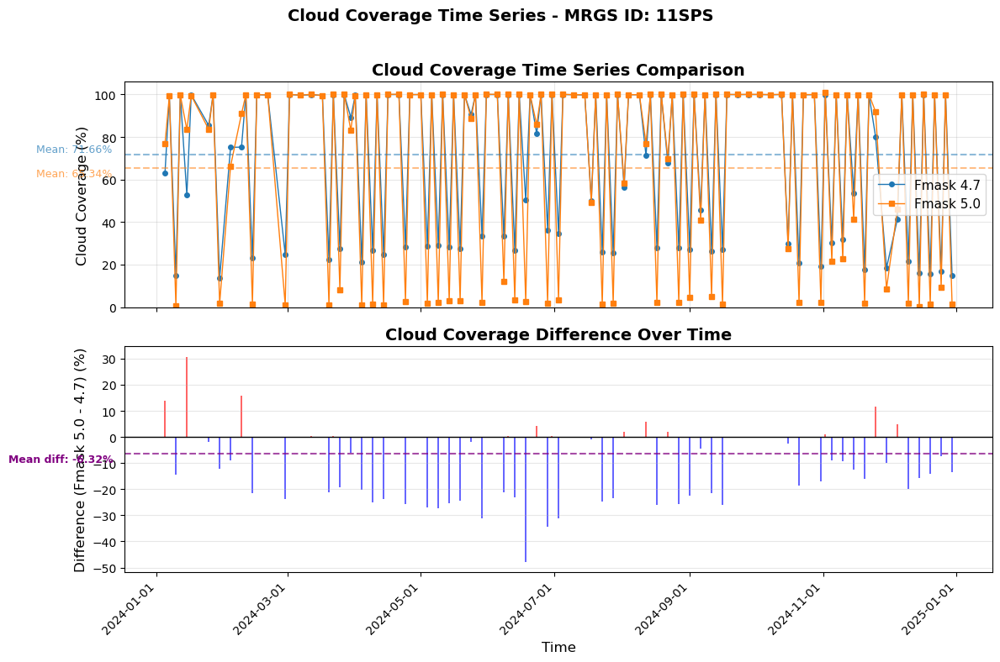

  ✓ Cloud coverage time series plotted (121 time steps)

[Step 4] Creating visualization for 11SPS...


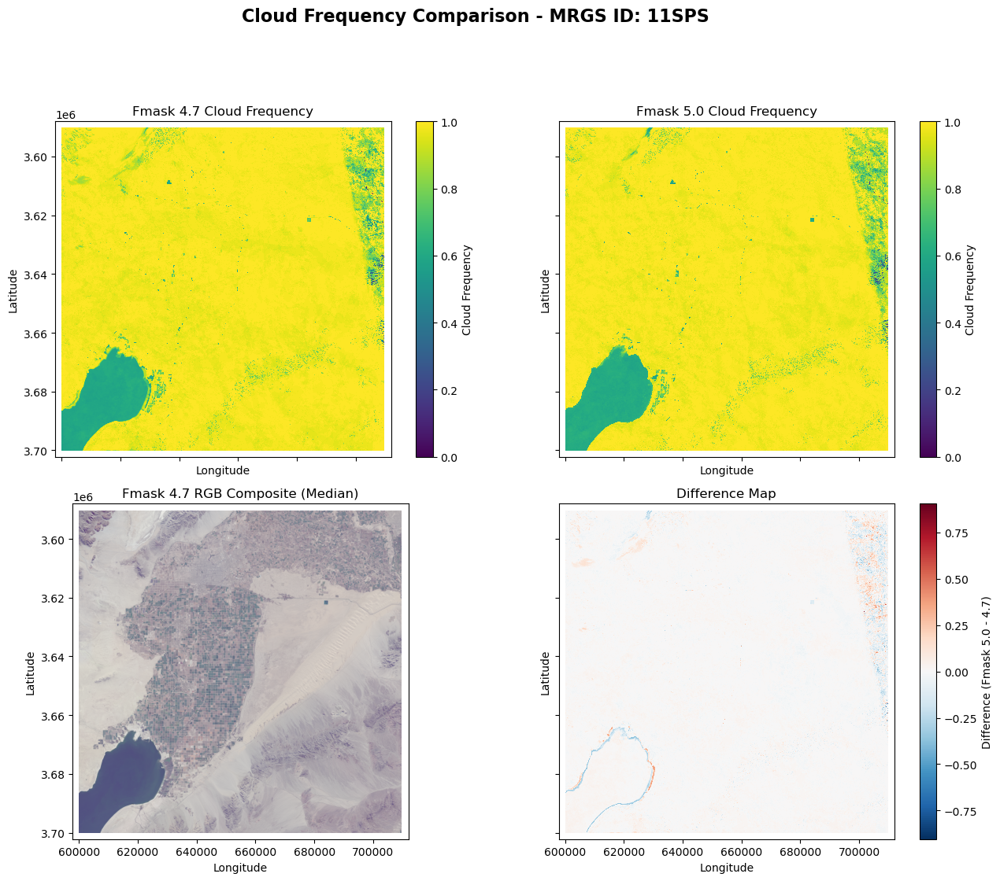

  ✓ Completed processing 11SPS

Processing MRGS ID 5/6: 18SUJ

[Step 1] Loading Fmask data for 18SUJ...
  Fmask 4.7 path: s3://hls-debug-output/Fmask4_outputs/TS/S30/18SUJ/
  Fmask 5.0 path: s3://hls-debug-output/Fmask5_outputs/TS/S30/18SUJ/

Loading Fmask data for MRGS ID: 18SUJ
Fmask 4.7: Found 111 matching files in bucket 'hls-debug-output'
  Sample files (first 3):
    - Fmask4_outputs/TS/S30/18SUJ/HLS.S30.T18SUJ.2024003T160651.v2.0.Fmask.tif
    - Fmask4_outputs/TS/S30/18SUJ/HLS.S30.T18SUJ.2024005T155639.v2.0.Fmask.tif
    - Fmask4_outputs/TS/S30/18SUJ/HLS.S30.T18SUJ.2024008T160639.v2.0.Fmask.tif
Fmask 5.0: Found 147 matching files in bucket 'hls-debug-output'
  Sample files (first 3):
    - Fmask5_outputs/TS/S30/18SUJ/HLS.S30.T18SUJ.2024003.1.toa.Fmask.tif
    - Fmask5_outputs/TS/S30/18SUJ/HLS.S30.T18SUJ.2024005.1.toa.Fmask.tif
    - Fmask5_outputs/TS/S30/18SUJ/HLS.S30.T18SUJ.2024008.1.toa.Fmask.tif

  ✗ Error processing 18SUJ: Reindexing only valid with uniquely valued Index obj

Traceback (most recent call last):
  File "/var/folders/qq/g5z8h46d6ldfjb7csbf4q6z40000gn/T/ipykernel_88514/3509736661.py", line 188, in batch_time_series_comparison
    fmask_pair = load_fmask_pair(
                 ^^^^^^^^^^^^^^^^
  File "/var/folders/qq/g5z8h46d6ldfjb7csbf4q6z40000gn/T/ipykernel_88514/2415930194.py", line 690, in load_fmask_pair
    fmask5_matched = fmask5_stack.sel(time=common_times)
                     ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/anaconda3/envs/lpdaac_vitals/lib/python3.12/site-packages/xarray/core/dataarray.py", line 1716, in sel
    ds = self._to_temp_dataset().sel(
         ^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/anaconda3/envs/lpdaac_vitals/lib/python3.12/site-packages/xarray/core/dataset.py", line 2982, in sel
    query_results = map_index_queries(
                    ^^^^^^^^^^^^^^^^^^
  File "/opt/anaconda3/envs/lpdaac_vitals/lib/python3.12/site-packages/xarray/core/indexing.py", line 201, in map_index_queries
    results.append(ind


Processing MRGS ID 6/6: 18TWL

[Step 1] Loading Fmask data for 18TWL...
  Fmask 4.7 path: s3://hls-debug-output/Fmask4_outputs/TS/S30/18TWL/
  Fmask 5.0 path: s3://hls-debug-output/Fmask5_outputs/TS/S30/18TWL/

Loading Fmask data for MRGS ID: 18TWL
Fmask 4.7: Found 111 matching files in bucket 'hls-debug-output'
  Sample files (first 3):
    - Fmask4_outputs/TS/S30/18TWL/HLS.S30.T18TWL.2024002T154649.v2.0.Fmask.tif
    - Fmask4_outputs/TS/S30/18TWL/HLS.S30.T18TWL.2024005T155639.v2.0.Fmask.tif
    - Fmask4_outputs/TS/S30/18TWL/HLS.S30.T18TWL.2024010T155631.v2.0.Fmask.tif
Fmask 5.0: Found 145 matching files in bucket 'hls-debug-output'
  Sample files (first 3):
    - Fmask5_outputs/TS/S30/18TWL/HLS.S30.T18TWL.2024002.1.toa.Fmask.tif
    - Fmask5_outputs/TS/S30/18TWL/HLS.S30.T18TWL.2024005.1.toa.Fmask.tif
    - Fmask5_outputs/TS/S30/18TWL/HLS.S30.T18TWL.2024007.1.toa.Fmask.tif

Matched 111 common time steps out of 111 (Fmask 4.7) and 145 (Fmask 5.0) total time steps
Selected top 10 clear

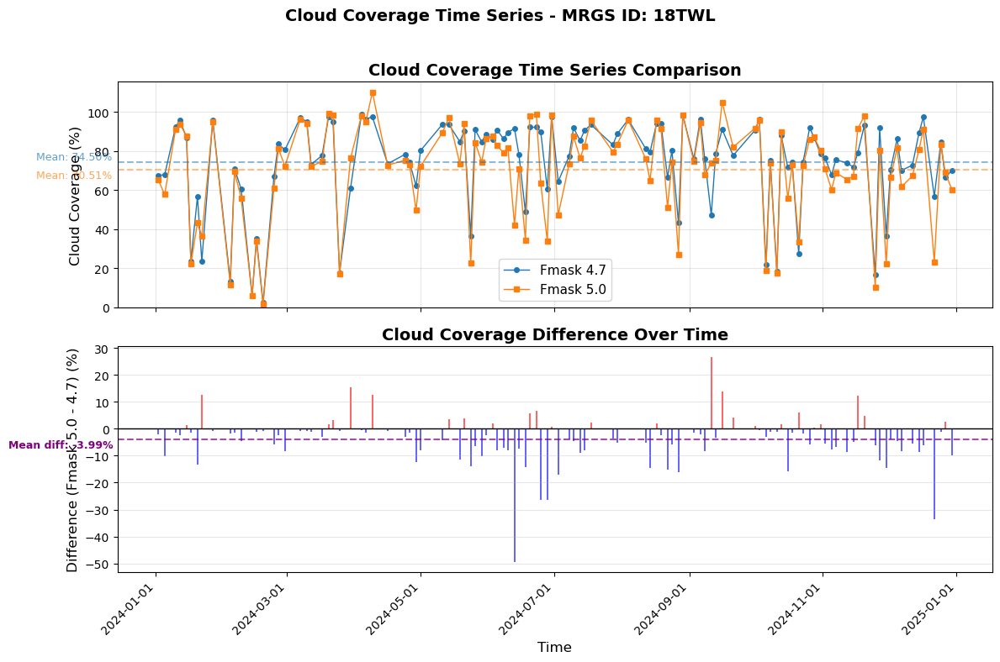

  ✓ Cloud coverage time series plotted (111 time steps)

[Step 4] Creating visualization for 18TWL...


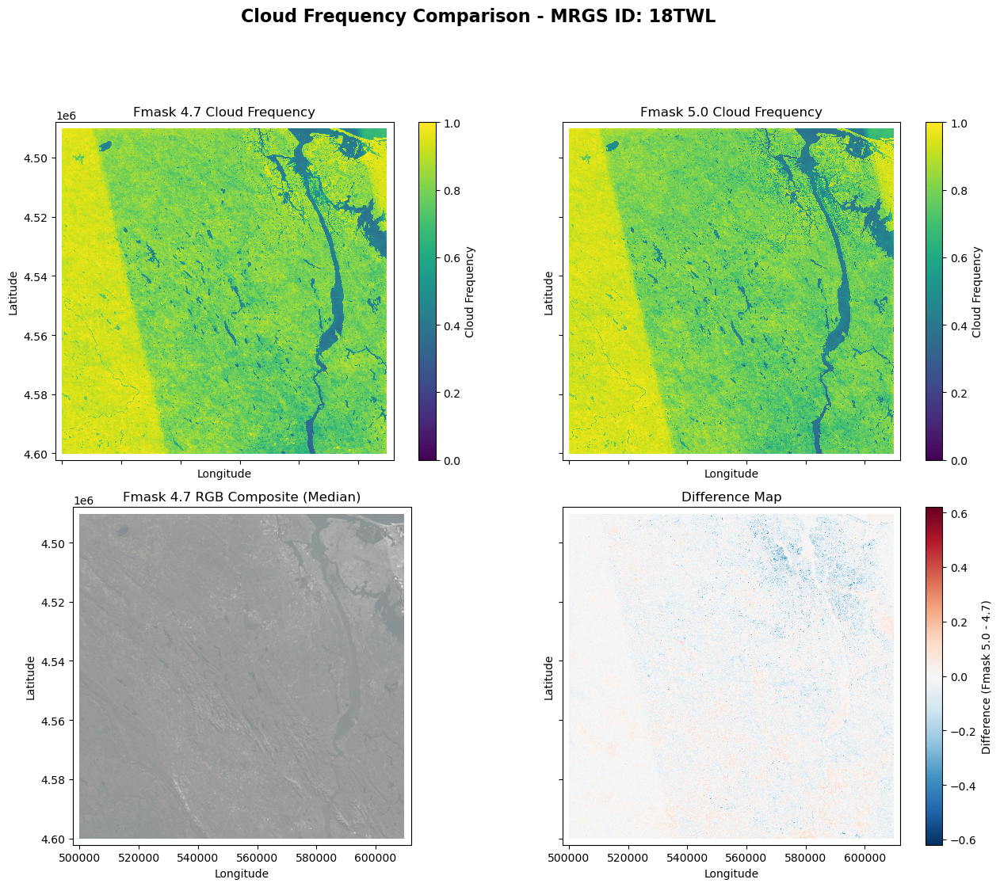

  ✓ Completed processing 18TWL

Batch processing complete!
  Successfully processed: 5
  Skipped: 0
  Errors: 1



In [2]:
# Example: Batch process multiple MRGS IDs
# This will create a 2x2 panel plot and time series plot for each MRGS ID
sat_id = 'S30'
# Paths ending with '/' will have MRGS ID automatically appended
# Alternative: use placeholder pattern 's3://bucket/path/{mrgs_id}/'
s3_Fmask47 = 's3://hls-debug-output/Fmask4_outputs/TS/'+sat_id+'/'
s3_Fmask5 = 's3://hls-debug-output/Fmask5_outputs/TS/'+sat_id+'/'

# Define list of MRGS IDs to process
mrgs_id_list = ['31UDQ', '11SLT', '42QWM','11SPS','18SUJ','18TWL']

# Run batch processing
# Note: Make sure to run the required modules first:
# %run module/data_access.ipynb
# %run module/plotting.ipynb

results = batch_time_series_comparison(
    mrgs_id_list=mrgs_id_list,
    bucket='hls-debug-output',
    fmask4_files=s3_Fmask47,   # S3 link to Fmask 4.7 outputs (MRGS ID will be appended
    fmask5_files=s3_Fmask5,    # S3 link to Fmask 5.0 outputs (MRGS ID will be appended)
    output_dir='./outputs',
    min_valid_ratio=0.6,        # 60% valid pixels required for RGB time steps
    vmin=0.0,
    vmax=1.0,
    cmap='viridis',             # Better color scheme for frequency visualization
    figsize=(15, 12),
    export=False,                # Set to True to save plots and data files
    show_plot=True,              # Set to False to suppress plot display
    auto_zoom=True               # Shared zoom across all panels,
    mask_value=4)  # 4 for cloud (default)
)


### 7. Focused Investigation of a Specific MRGS ID

This section demonstrates how to perform a detailed investigation of a single MRGS ID using the batch processing workflow. This approach is useful when you want to:

- Conduct an in-depth analysis of a specific geographic region
- Debug data loading or processing issues for a particular tile
- Generate detailed visualizations and statistics for a single location
- Validate data quality and completeness for a specific MRGS ID

The workflow follows the same steps as batch processing but focuses on a single MRGS ID, allowing for more detailed inspection of intermediate results and outputs.



Batch Cloud Time Series Comparison
Processing 1 MRGS IDs: ['42QWM']


Processing MRGS ID 1/1: 42QWM

[Step 1] Loading Fmask data for 42QWM...
  Fmask 4.7 path: s3://hls-debug-output/Fmask4_outputs/TS/S30/42QWM/
  Fmask 5.0 path: s3://hls-debug-output/Fmask5_outputs/TS/S30/42QWM/

Loading Fmask data for MRGS ID: 42QWM
Fmask 4.7: Found 132 matching files in bucket 'hls-debug-output'
  Sample files (first 3):
    - Fmask4_outputs/TS/S30/42QWM/HLS.S30.T42QWM.2024003T060241.v2.0.Fmask.tif
    - Fmask4_outputs/TS/S30/42QWM/HLS.S30.T42QWM.2024005T055229.v2.0.Fmask.tif
    - Fmask4_outputs/TS/S30/42QWM/HLS.S30.T42QWM.2024008T060229.v2.0.Fmask.tif
Fmask 5.0: Found 142 matching files in bucket 'hls-debug-output'
  Sample files (first 3):
    - Fmask5_outputs/TS/S30/42QWM/HLS.S30.T42QWM.2024003.1.toa.Fmask.tif
    - Fmask5_outputs/TS/S30/42QWM/HLS.S30.T42QWM.2024005.1.toa.Fmask.tif
    - Fmask5_outputs/TS/S30/42QWM/HLS.S30.T42QWM.2024008.1.toa.Fmask.tif

Matched 132 common time steps out of 132 (

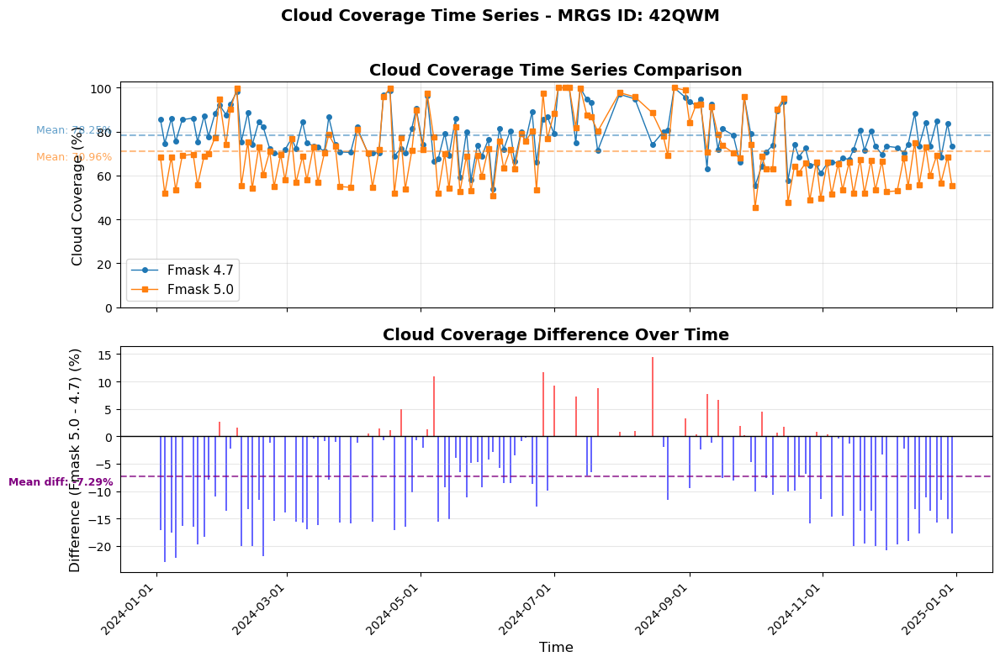

  ✓ Cloud coverage time series plotted (132 time steps)

[Step 4] Creating visualization for 42QWM...


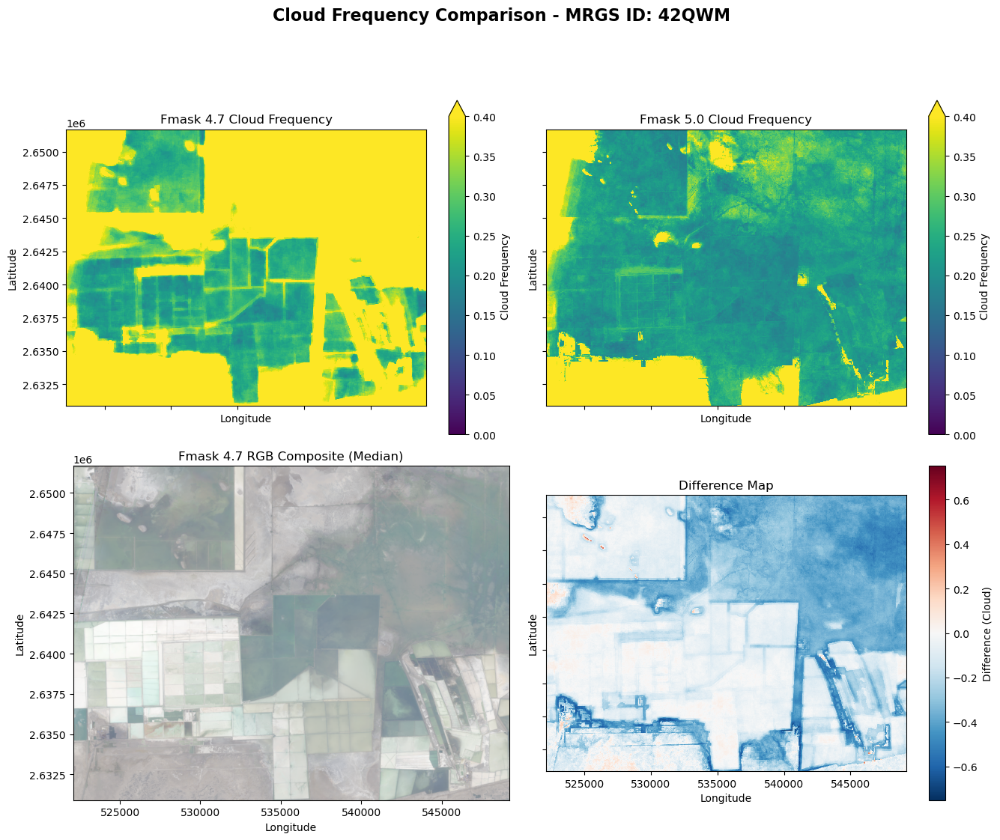

  ✓ Completed processing 42QWM

Batch processing complete!
  Successfully processed: 1
  Skipped: 0
  Errors: 0


--- Detailed Cloud Shadow Results for MRGS ID: 42QWM ---
Fmask 4.7 shadow frequency shape: (3660, 3660)
Fmask 5.0 shadow frequency shape: (3660, 3660)
Fmask 4.7 shadow frequency range: 0.156 to 1.000
Fmask 5.0 shadow frequency range: 0.146 to 1.000

Cloud shadow coverage time series summary:
  Mean Fmask 4.7 shadow coverage: 78.25%
  Mean Fmask 5.0 shadow coverage: 70.96%
  Mean difference (Fmask 5.0 - 4.7): -7.29%
  Time range: 2024-01-03 to 2024-12-30

First 5 rows of cloud shadow coverage DataFrame:
        time  fmask4_coverage  fmask5_coverage  difference
0 2024-01-03        85.644706        68.570561  -17.074145
1 2024-01-05        74.652506        51.801516  -22.850991
2 2024-01-08        85.926671        68.376703  -17.549968
3 2024-01-10        75.483123        53.315098  -22.168025
4 2024-01-13        85.472483        69.108928  -16.363555


In [13]:
# Section 9: Focused cloud mask investigation for a single MRGS ID

# Choose plotting mode: "interactive" (qt5) or "static" (inline)
PLOT_MODE = "static"  # change to "interactive" if you want interactive windows

# Configuration
sat_id = 'S30'
# Choose a specific MRGS ID for detailed cloud shadow investigation
target_mrgs_id = '42QWM'

# S3 paths (MRGS ID will be automatically appended by batch_time_series_comparison)
s3_Fmask47 = f's3://hls-debug-output/Fmask4_outputs/TS/{sat_id}/'
s3_Fmask5 = f's3://hls-debug-output/Fmask5_outputs/TS/{sat_id}/'

# Optional: Define custom extent (x_min, x_max, y_min, y_max) to zoom into a specific region
# If None, auto_zoom will calculate extent from data bounds
# extent = None  # Set to None to use auto_zoom, or provide tuple (x_min, x_max, y_min, y_max)
extent = (522094.8, 549190.7, 2630893.0, 2651678.9)



single_cloud_results = batch_time_series_comparison(
    mrgs_id_list=[target_mrgs_id],  # Pass as a list for batch function
    bucket='hls-debug-output',
    fmask4_files=s3_Fmask47,
    fmask5_files=s3_Fmask5,
    output_dir='./outputs',
    min_valid_ratio=0.6,
    vmin=0.0,
    vmax=0.4,                 # narrower range is often useful for cloud shadow
    cmap='viridis',
    figsize=(15, 12),
    export=False,
    show_plot=True,
    auto_zoom=True,
    mask_value=4,             # 4 for cloud mask
    extent=extent             # Custom extent (x_min, x_max, y_min, y_max) or None for auto
)

# Inspect detailed results for the chosen MRGS ID
if target_mrgs_id in single_cloud_results:
    result = single_cloud_results[target_mrgs_id]
    if result['status'] == 'success':
        print(f"\n--- Detailed Cloud Shadow Results for MRGS ID: {target_mrgs_id} ---")
        f4_freq = result['fmask4_frequency']
        f5_freq = result['fmask5_frequency']
        print(f"Fmask 4.7 shadow frequency shape: {f4_freq.shape}")
        print(f"Fmask 5.0 shadow frequency shape: {f5_freq.shape}")
        print(f"Fmask 4.7 shadow frequency range: {f4_freq.min().values:.3f} to {f4_freq.max().values:.3f}")
        print(f"Fmask 5.0 shadow frequency range: {f5_freq.min().values:.3f} to {f5_freq.max().values:.3f}")

        if result['cloud_coverage_df'] is not None:
            df = result['cloud_coverage_df']
            print("\nCloud shadow coverage time series summary:")
            print(f"  Mean Fmask 4.7 shadow coverage: {df['fmask4_coverage'].mean():.2f}%")
            print(f"  Mean Fmask 5.0 shadow coverage: {df['fmask5_coverage'].mean():.2f}%")
            print(f"  Mean difference (Fmask 5.0 - 4.7): {df['difference'].mean():.2f}%")
            print(f"  Time range: {df['time'].min().strftime('%Y-%m-%d')} to {df['time'].max().strftime('%Y-%m-%d')}")
            print("\nFirst 5 rows of cloud shadow coverage DataFrame:")
            print(df.head())
        else:
            print("\nNo cloud shadow coverage time series data available.")
    else:
        print(f"Processing for {target_mrgs_id} was {result['status']}: {result.get('reason', result.get('error', 'Unknown error'))}")
else:
    print(f"No results found for MRGS ID: {target_mrgs_id}")

# Note: If you want to apply a custom extent, set the 'extent' variable above
# before calling batch_time_series_comparison. The extent will be applied to all plot panels.
# Example: extent = (522094.8, 549190.7, 2630893.0, 2651678.9)
# 
# Alternatively, you can manually adjust the extent after plotting by accessing the figure:
# if target_mrgs_id in single_shadow_results and single_shadow_results[target_mrgs_id]['status'] == 'success':
#     fig = single_shadow_results[target_mrgs_id]['fig']
#     axes = single_shadow_results[target_mrgs_id]['axes']
#     for ax in axes:
#         if ax.get_visible():
#             ax.set_xlim(522094.8, 549190.7)
#             ax.set_ylim(2630893.0, 2651678.9)
#     plt.show()  # Re-display with updated extent


### 8. Batch Time Series Comparison for Cloud Shadow Mask

This section performs the same batch time series comparison workflow as Section 6, but focuses on **cloud shadow detection** instead of cloud detection. Cloud shadow has a unique code value of **2** in the Fmask classification scheme (compared to **4** for clouds).

**Note:** This section uses the same consolidated functions as Section 6, but with `mask_value=2` to analyze cloud shadow instead of cloud. The functions `calculate_cloud_frequency_per_pixel`, `calculate_cloud_coverage_timeseries`, `visualize_and_export_cloud_frequency`, and `batch_time_series_comparison` all accept a `mask_value` parameter to specify which mask type to analyze.

The workflow includes:
- Calculating cloud shadow frequency per pixel for Fmask 4.7 and 5.0
- Generating time series plots of cloud shadow coverage over time
- Creating 2x2 panel visualizations comparing cloud shadow detection between versions
- Computing difference maps to highlight areas where cloud shadow detection differs


Batch Cloud Shadow Time Series Comparison
Processing 6 MRGS IDs: ['31UDQ', '11SLT', '42QWM', '11SPS', '18SUJ', '18TWL']


Processing MRGS ID 1/6: 31UDQ

[Step 1] Loading Fmask data for 31UDQ...
  Fmask 4.7 path: s3://hls-debug-output/Fmask4_outputs/TS/S30/31UDQ/
  Fmask 5.0 path: s3://hls-debug-output/Fmask5_outputs/TS/S30/31UDQ/

Loading Fmask data for MRGS ID: 31UDQ
Fmask 4.7: Found 97 matching files in bucket 'hls-debug-output'
  Sample files (first 3):
    - Fmask4_outputs/TS/S30/31UDQ/HLS.S30.T31UDQ.2024003T110441.v2.0.Fmask.tif
    - Fmask4_outputs/TS/S30/31UDQ/HLS.S30.T31UDQ.2024005T105339.v2.0.Fmask.tif
    - Fmask4_outputs/TS/S30/31UDQ/HLS.S30.T31UDQ.2024008T110339.v2.0.Fmask.tif
Fmask 5.0: Found 145 matching files in bucket 'hls-debug-output'
  Sample files (first 3):
    - Fmask5_outputs/TS/S30/31UDQ/HLS.S30.T31UDQ.2024003.1.toa.Fmask.tif
    - Fmask5_outputs/TS/S30/31UDQ/HLS.S30.T31UDQ.2024005.1.toa.Fmask.tif
    - Fmask5_outputs/TS/S30/31UDQ/HLS.S30.T31UDQ.2024008.1.toa.Fm

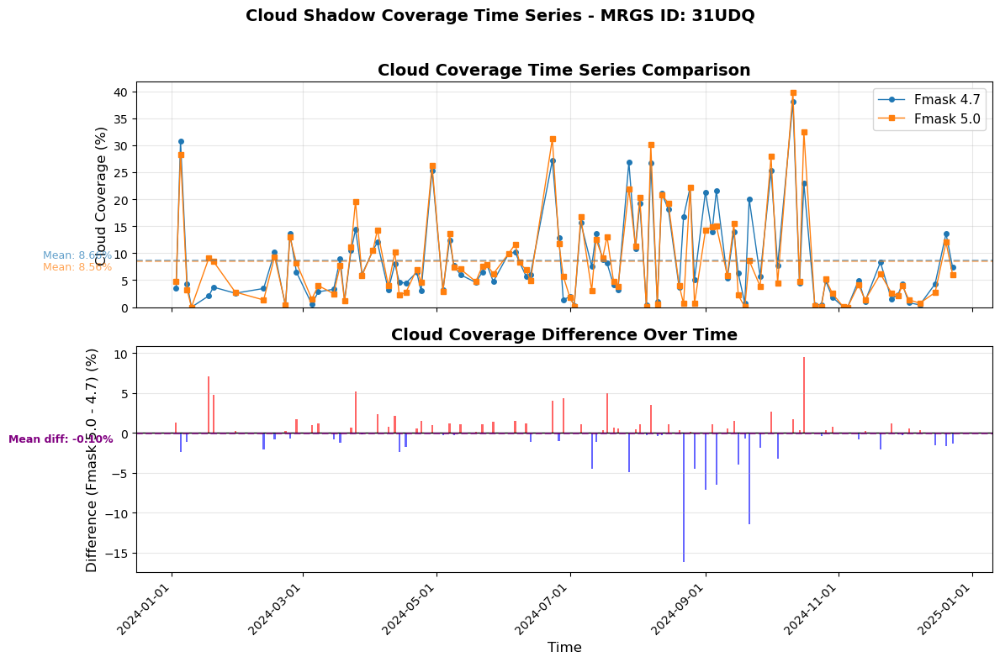

  ✓ Cloud Shadow coverage time series plotted (97 time steps)

[Step 4] Creating visualization for 31UDQ...


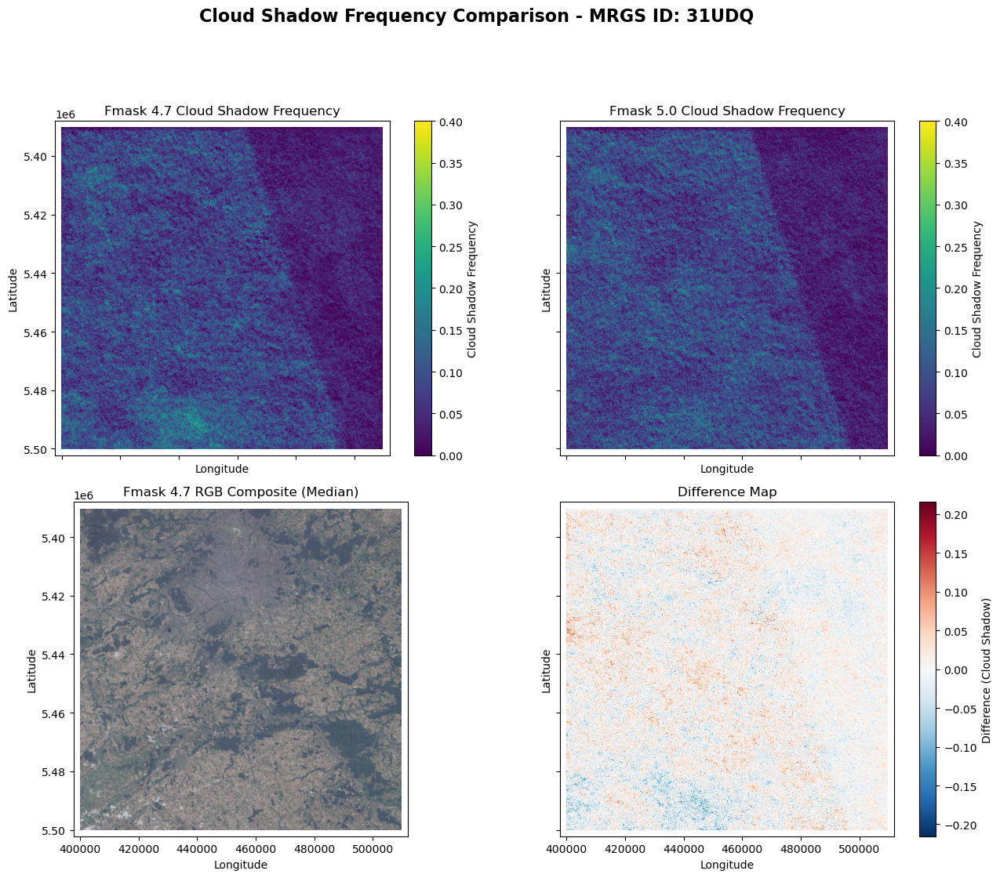

  ✓ Completed processing 31UDQ

Processing MRGS ID 2/6: 11SLT

[Step 1] Loading Fmask data for 11SLT...
  Fmask 4.7 path: s3://hls-debug-output/Fmask4_outputs/TS/S30/11SLT/
  Fmask 5.0 path: s3://hls-debug-output/Fmask5_outputs/TS/S30/11SLT/

Loading Fmask data for MRGS ID: 11SLT
Fmask 4.7: Found 133 matching files in bucket 'hls-debug-output'
  Sample files (first 3):
    - Fmask4_outputs/TS/S30/11SLT/HLS.S30.T11SLT.2024003T183749.v2.0.Fmask.tif
    - Fmask4_outputs/TS/S30/11SLT/HLS.S30.T11SLT.2024006T184749.v2.0.Fmask.tif
    - Fmask4_outputs/TS/S30/11SLT/HLS.S30.T11SLT.2024008T183741.v2.0.Fmask.tif
Fmask 5.0: Found 141 matching files in bucket 'hls-debug-output'
  Sample files (first 3):
    - Fmask5_outputs/TS/S30/11SLT/HLS.S30.T11SLT.2024001.1.toa.Fmask.tif
    - Fmask5_outputs/TS/S30/11SLT/HLS.S30.T11SLT.2024003.1.toa.Fmask.tif
    - Fmask5_outputs/TS/S30/11SLT/HLS.S30.T11SLT.2024006.1.toa.Fmask.tif

Matched 133 common time steps out of 133 (Fmask 4.7) and 141 (Fmask 5.0) total t

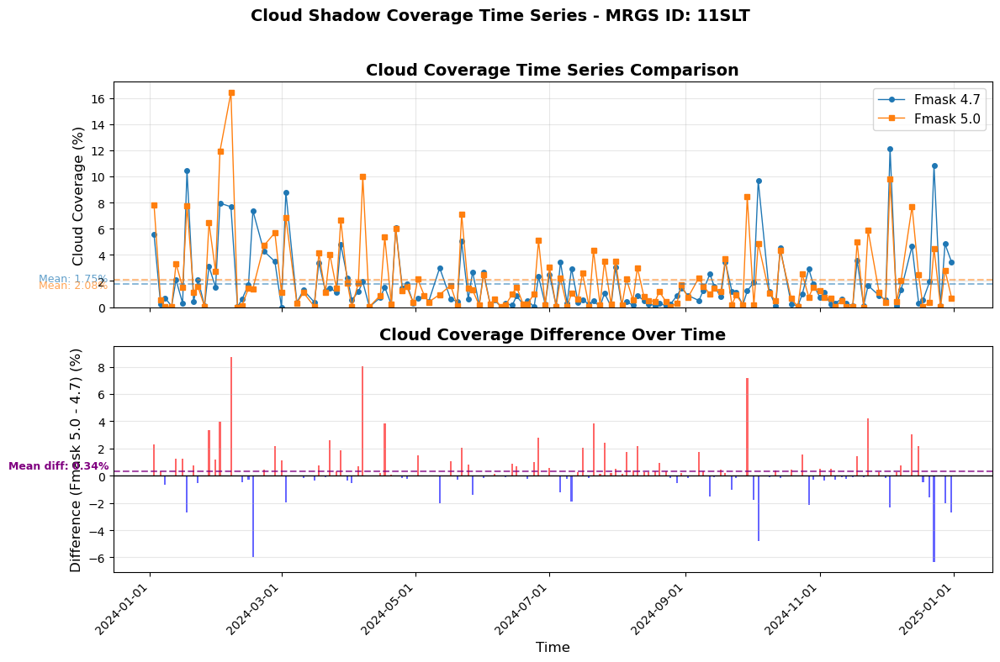

  ✓ Cloud Shadow coverage time series plotted (133 time steps)

[Step 4] Creating visualization for 11SLT...


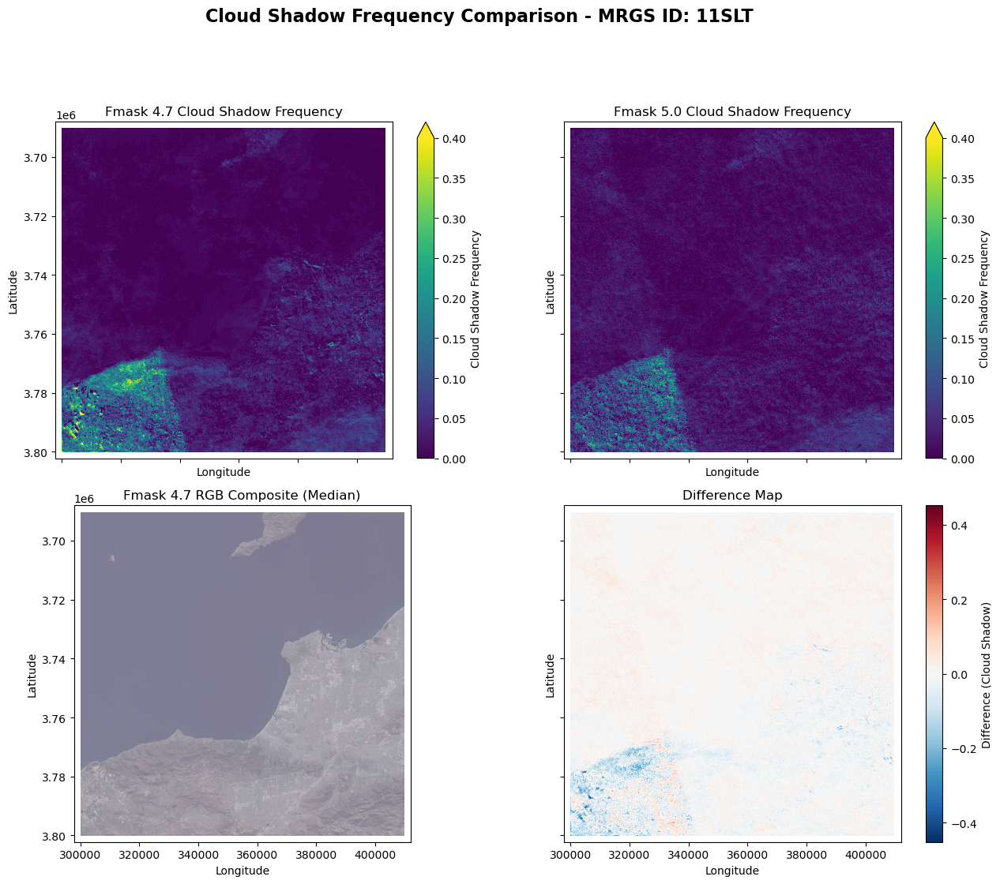

  ✓ Completed processing 11SLT

Processing MRGS ID 3/6: 42QWM

[Step 1] Loading Fmask data for 42QWM...
  Fmask 4.7 path: s3://hls-debug-output/Fmask4_outputs/TS/S30/42QWM/
  Fmask 5.0 path: s3://hls-debug-output/Fmask5_outputs/TS/S30/42QWM/

Loading Fmask data for MRGS ID: 42QWM
Fmask 4.7: Found 132 matching files in bucket 'hls-debug-output'
  Sample files (first 3):
    - Fmask4_outputs/TS/S30/42QWM/HLS.S30.T42QWM.2024003T060241.v2.0.Fmask.tif
    - Fmask4_outputs/TS/S30/42QWM/HLS.S30.T42QWM.2024005T055229.v2.0.Fmask.tif
    - Fmask4_outputs/TS/S30/42QWM/HLS.S30.T42QWM.2024008T060229.v2.0.Fmask.tif
Fmask 5.0: Found 142 matching files in bucket 'hls-debug-output'
  Sample files (first 3):
    - Fmask5_outputs/TS/S30/42QWM/HLS.S30.T42QWM.2024003.1.toa.Fmask.tif
    - Fmask5_outputs/TS/S30/42QWM/HLS.S30.T42QWM.2024005.1.toa.Fmask.tif
    - Fmask5_outputs/TS/S30/42QWM/HLS.S30.T42QWM.2024008.1.toa.Fmask.tif

Matched 132 common time steps out of 132 (Fmask 4.7) and 142 (Fmask 5.0) total t

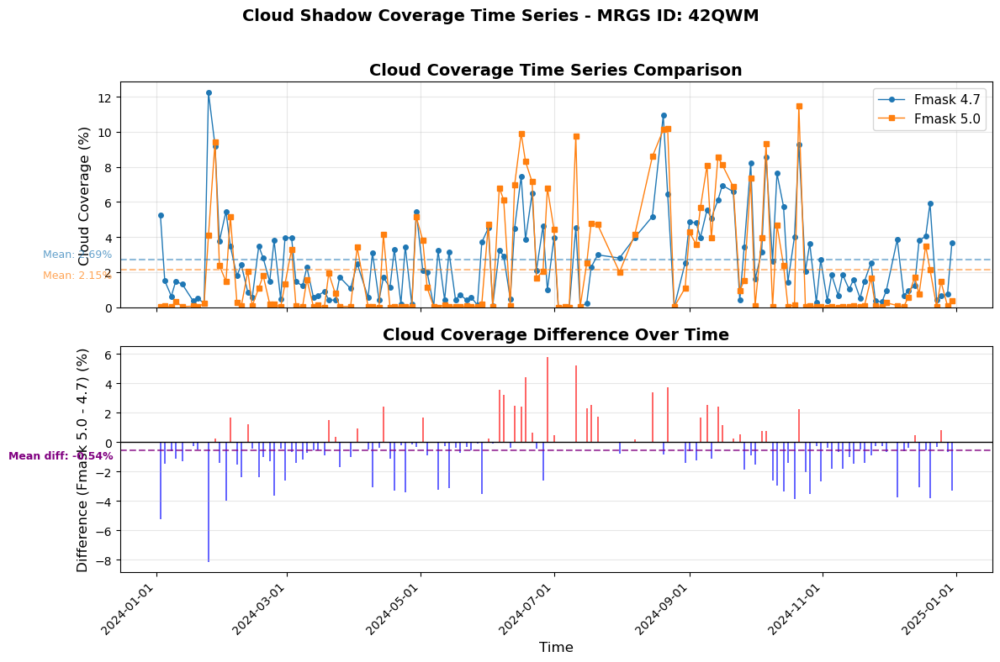

  ✓ Cloud Shadow coverage time series plotted (132 time steps)

[Step 4] Creating visualization for 42QWM...


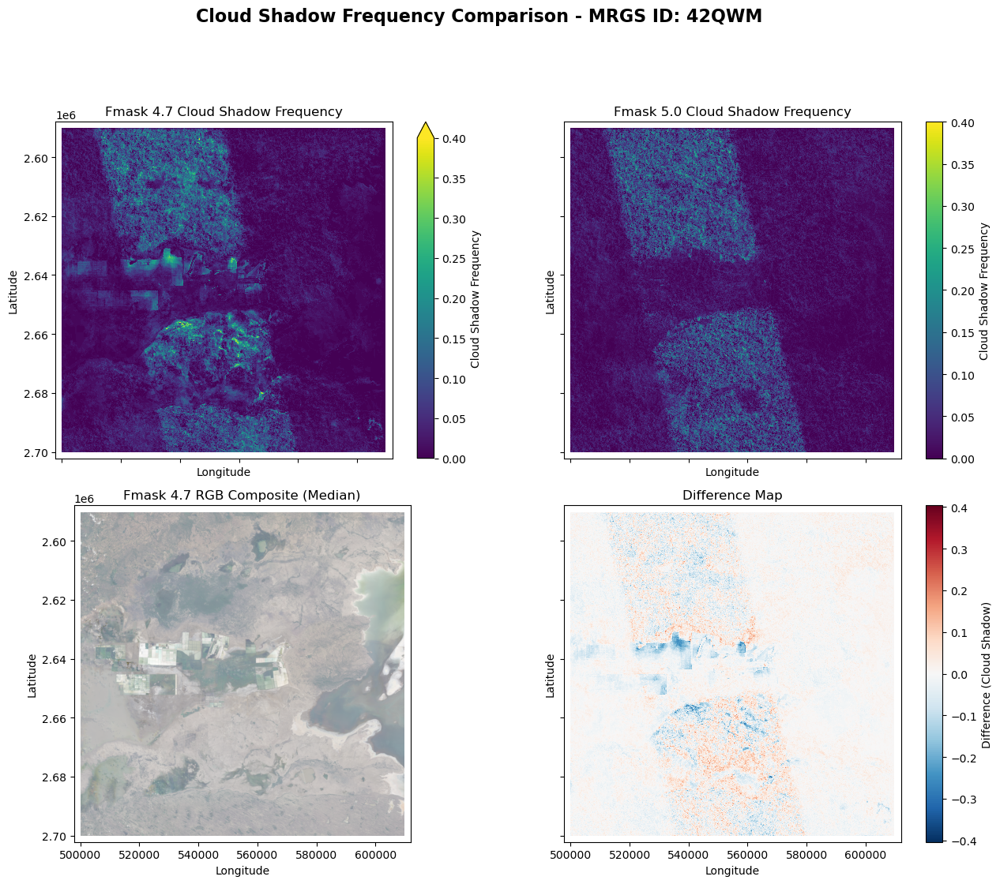

  ✓ Completed processing 42QWM

Processing MRGS ID 4/6: 11SPS

[Step 1] Loading Fmask data for 11SPS...
  Fmask 4.7 path: s3://hls-debug-output/Fmask4_outputs/TS/S30/11SPS/
  Fmask 5.0 path: s3://hls-debug-output/Fmask5_outputs/TS/S30/11SPS/

Loading Fmask data for MRGS ID: 11SPS
Fmask 4.7: Found 121 matching files in bucket 'hls-debug-output'
  Sample files (first 3):
    - Fmask4_outputs/TS/S30/11SPS/HLS.S30.T11SPS.2024005T182741.v2.0.Fmask.tif
    - Fmask4_outputs/TS/S30/11SPS/HLS.S30.T11SPS.2024007T181739.v2.0.Fmask.tif
    - Fmask4_outputs/TS/S30/11SPS/HLS.S30.T11SPS.2024010T182729.v2.0.Fmask.tif
Fmask 5.0: Found 130 matching files in bucket 'hls-debug-output'
  Sample files (first 3):
    - Fmask5_outputs/TS/S30/11SPS/HLS.S30.T11SPS.2024005.1.toa.Fmask.tif
    - Fmask5_outputs/TS/S30/11SPS/HLS.S30.T11SPS.2024007.1.toa.Fmask.tif
    - Fmask5_outputs/TS/S30/11SPS/HLS.S30.T11SPS.2024010.1.toa.Fmask.tif

Matched 121 common time steps out of 121 (Fmask 4.7) and 130 (Fmask 5.0) total t

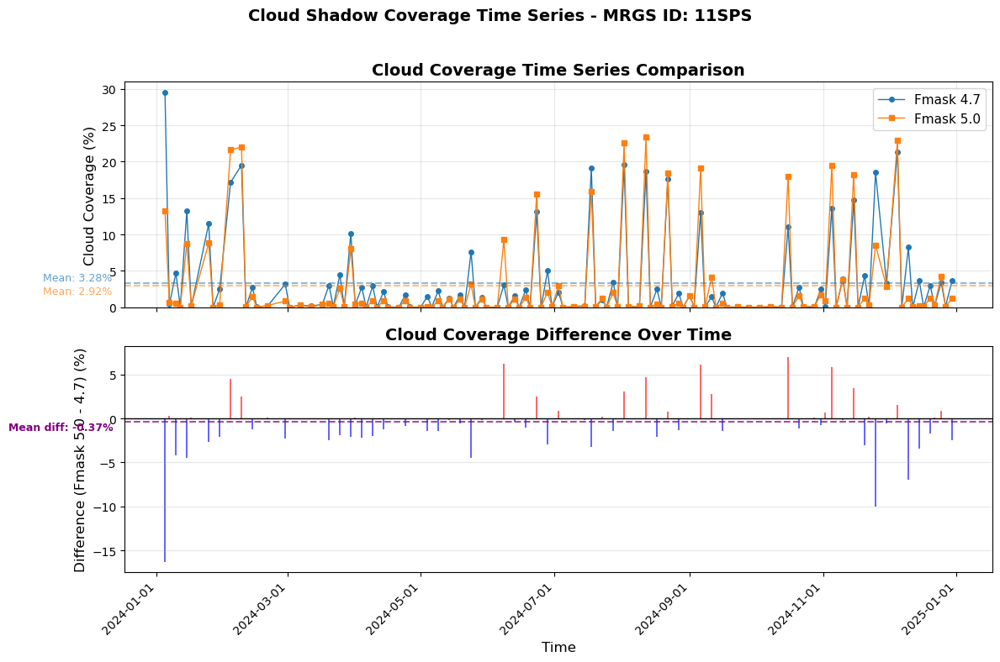

  ✓ Cloud Shadow coverage time series plotted (121 time steps)

[Step 4] Creating visualization for 11SPS...


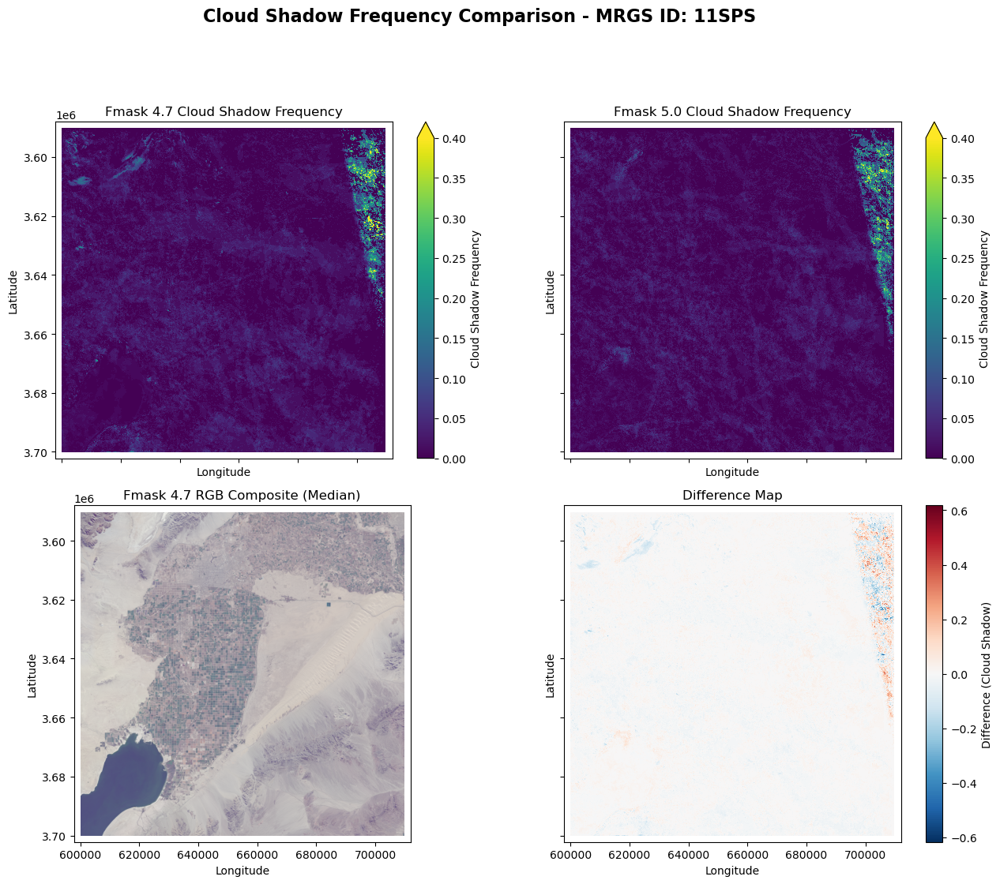

  ✓ Completed processing 11SPS

Processing MRGS ID 5/6: 18SUJ

[Step 1] Loading Fmask data for 18SUJ...
  Fmask 4.7 path: s3://hls-debug-output/Fmask4_outputs/TS/S30/18SUJ/
  Fmask 5.0 path: s3://hls-debug-output/Fmask5_outputs/TS/S30/18SUJ/

Loading Fmask data for MRGS ID: 18SUJ
Fmask 4.7: Found 111 matching files in bucket 'hls-debug-output'
  Sample files (first 3):
    - Fmask4_outputs/TS/S30/18SUJ/HLS.S30.T18SUJ.2024003T160651.v2.0.Fmask.tif
    - Fmask4_outputs/TS/S30/18SUJ/HLS.S30.T18SUJ.2024005T155639.v2.0.Fmask.tif
    - Fmask4_outputs/TS/S30/18SUJ/HLS.S30.T18SUJ.2024008T160639.v2.0.Fmask.tif
Fmask 5.0: Found 147 matching files in bucket 'hls-debug-output'
  Sample files (first 3):
    - Fmask5_outputs/TS/S30/18SUJ/HLS.S30.T18SUJ.2024003.1.toa.Fmask.tif
    - Fmask5_outputs/TS/S30/18SUJ/HLS.S30.T18SUJ.2024005.1.toa.Fmask.tif
    - Fmask5_outputs/TS/S30/18SUJ/HLS.S30.T18SUJ.2024008.1.toa.Fmask.tif

  ✗ Error processing 18SUJ: Reindexing only valid with uniquely valued Index obj

Traceback (most recent call last):
  File "/var/folders/qq/g5z8h46d6ldfjb7csbf4q6z40000gn/T/ipykernel_18810/2432702341.py", line 183, in batch_time_series_comparison
    fmask_pair = load_fmask_pair(
                 ^^^^^^^^^^^^^^^^
  File "/var/folders/qq/g5z8h46d6ldfjb7csbf4q6z40000gn/T/ipykernel_18810/2415930194.py", line 690, in load_fmask_pair
    fmask5_matched = fmask5_stack.sel(time=common_times)
                     ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/anaconda3/envs/lpdaac_vitals/lib/python3.12/site-packages/xarray/core/dataarray.py", line 1716, in sel
    ds = self._to_temp_dataset().sel(
         ^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/anaconda3/envs/lpdaac_vitals/lib/python3.12/site-packages/xarray/core/dataset.py", line 2982, in sel
    query_results = map_index_queries(
                    ^^^^^^^^^^^^^^^^^^
  File "/opt/anaconda3/envs/lpdaac_vitals/lib/python3.12/site-packages/xarray/core/indexing.py", line 201, in map_index_queries
    results.append(ind


Processing MRGS ID 6/6: 18TWL

[Step 1] Loading Fmask data for 18TWL...
  Fmask 4.7 path: s3://hls-debug-output/Fmask4_outputs/TS/S30/18TWL/
  Fmask 5.0 path: s3://hls-debug-output/Fmask5_outputs/TS/S30/18TWL/

Loading Fmask data for MRGS ID: 18TWL
Fmask 4.7: Found 111 matching files in bucket 'hls-debug-output'
  Sample files (first 3):
    - Fmask4_outputs/TS/S30/18TWL/HLS.S30.T18TWL.2024002T154649.v2.0.Fmask.tif
    - Fmask4_outputs/TS/S30/18TWL/HLS.S30.T18TWL.2024005T155639.v2.0.Fmask.tif
    - Fmask4_outputs/TS/S30/18TWL/HLS.S30.T18TWL.2024010T155631.v2.0.Fmask.tif
Fmask 5.0: Found 145 matching files in bucket 'hls-debug-output'
  Sample files (first 3):
    - Fmask5_outputs/TS/S30/18TWL/HLS.S30.T18TWL.2024002.1.toa.Fmask.tif
    - Fmask5_outputs/TS/S30/18TWL/HLS.S30.T18TWL.2024005.1.toa.Fmask.tif
    - Fmask5_outputs/TS/S30/18TWL/HLS.S30.T18TWL.2024007.1.toa.Fmask.tif

Matched 111 common time steps out of 111 (Fmask 4.7) and 145 (Fmask 5.0) total time steps
Selected top 10 clear

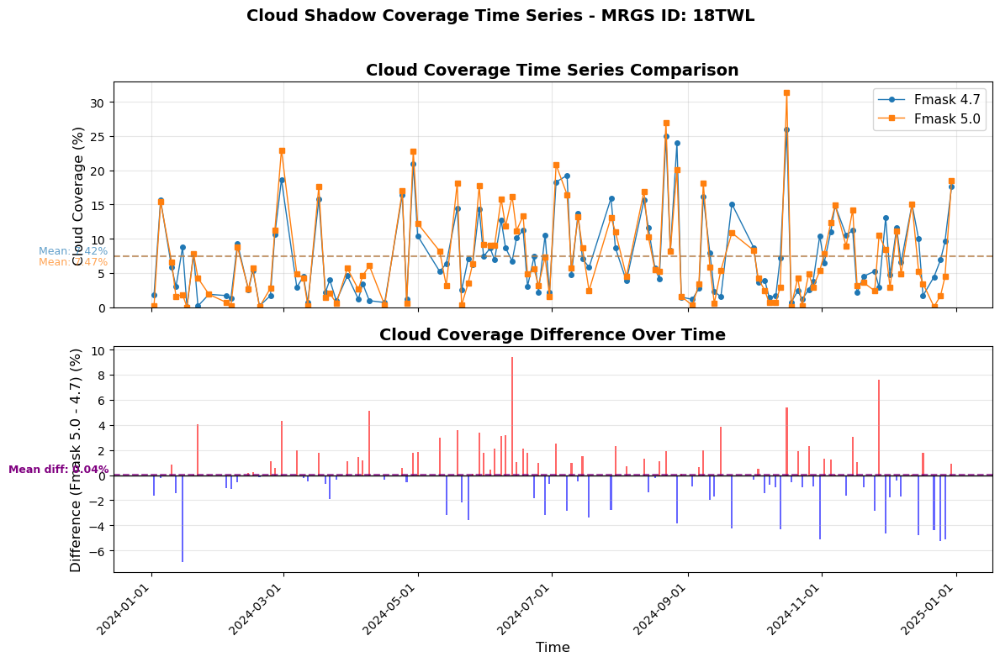

  ✓ Cloud Shadow coverage time series plotted (111 time steps)

[Step 4] Creating visualization for 18TWL...


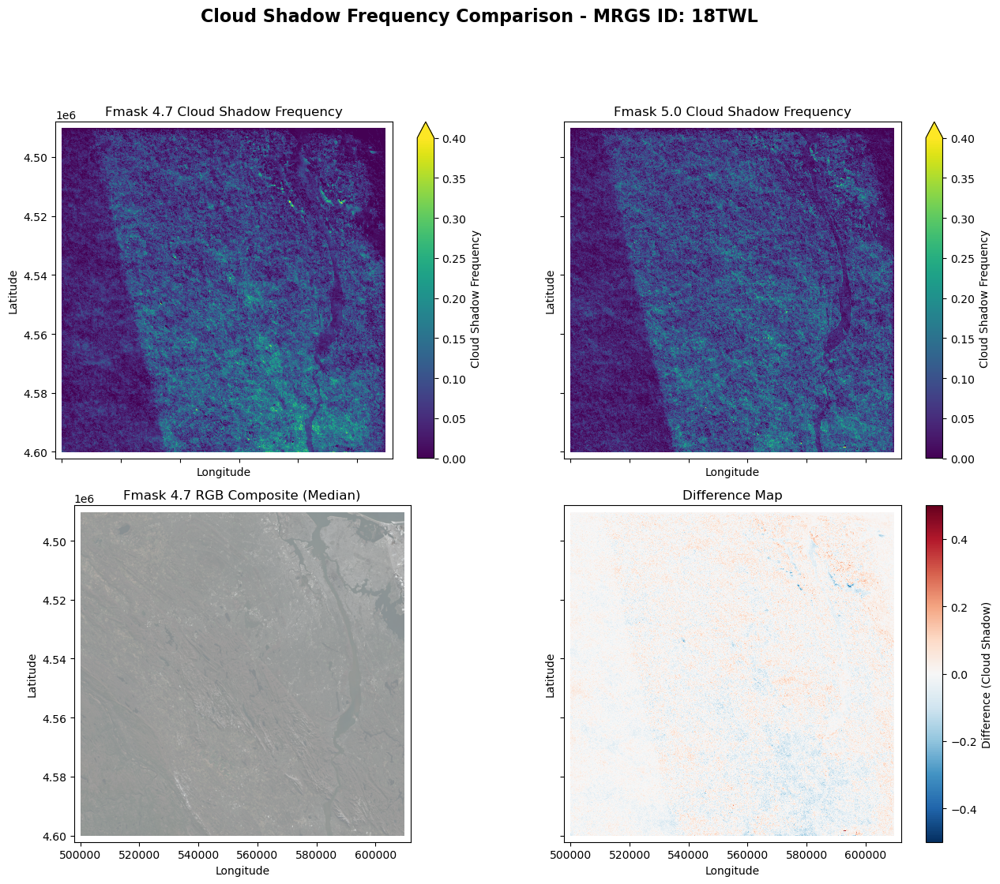

  ✓ Completed processing 18TWL

Batch processing complete!
  Successfully processed: 5
  Skipped: 0
  Errors: 1



In [2]:
# Section 8: Cloud Shadow Analysis using Consolidated Functions
# This section uses the same functions as Section 6, but with mask_value=2 for cloud shadow
# instead of mask_value=4 for cloud.

# Example: Batch process cloud shadow comparison for multiple MRGS IDs
sat_id = 'S30'
s3_Fmask47 = 's3://hls-debug-output/Fmask4_outputs/TS/'+sat_id+'/'
s3_Fmask5 = 's3://hls-debug-output/Fmask5_outputs/TS/'+sat_id+'/'

# Define list of MRGS IDs to process
mrgs_id_list = ['31UDQ', '11SLT', '42QWM', '11SPS', '18SUJ', '18TWL']

# Run batch cloud shadow processing
# Note: Make sure to run the required modules first:
# %run module/data_access.ipynb
# %run module/plotting.ipynb
# %run module/fmask.ipynb

# Use batch_time_series_comparison with mask_value=2 for cloud shadow
shadow_results = batch_time_series_comparison(
    mrgs_id_list=mrgs_id_list,
    bucket='hls-debug-output',
    fmask4_files=s3_Fmask47,
    fmask5_files=s3_Fmask5,
    output_dir='./outputs',
    min_valid_ratio=0.6,
    vmin=0.0,
    vmax=0.4,
    cmap='viridis',
    figsize=(15, 12),
    export=False,
    show_plot=True,
    auto_zoom=True,
    mask_value=2  # Use 2 for cloud shadow (instead of 4 for cloud)
)


### 9. Focused Cloud Shadow Investigation for a Specific MRGS ID

This section mirrors Section 7 but focuses specifically on **cloud shadow** (Fmask value = 2) for a single MRGS ID. It is useful when you want to:

- Examine how Fmask 4.7 and 5.0 differ in cloud shadow detection over a particular tile
- Debug shadow-related omissions/commissions for a single MRGS ID
- Inspect cloud shadow frequency maps, time series, and differences in detail

The workflow reuses the consolidated `batch_time_series_comparison` function with `mask_value=2`, and then inspects the returned results for the chosen MRGS ID.


Batch Cloud Shadow Time Series Comparison
Processing 1 MRGS IDs: ['42QWM']


Processing MRGS ID 1/1: 42QWM

[Step 1] Loading Fmask data for 42QWM...
  Fmask 4.7 path: s3://hls-debug-output/Fmask4_outputs/TS/S30/42QWM/
  Fmask 5.0 path: s3://hls-debug-output/Fmask5_outputs/TS/S30/42QWM/

Loading Fmask data for MRGS ID: 42QWM
Fmask 4.7: Found 132 matching files in bucket 'hls-debug-output'
  Sample files (first 3):
    - Fmask4_outputs/TS/S30/42QWM/HLS.S30.T42QWM.2024003T060241.v2.0.Fmask.tif
    - Fmask4_outputs/TS/S30/42QWM/HLS.S30.T42QWM.2024005T055229.v2.0.Fmask.tif
    - Fmask4_outputs/TS/S30/42QWM/HLS.S30.T42QWM.2024008T060229.v2.0.Fmask.tif
Fmask 5.0: Found 142 matching files in bucket 'hls-debug-output'
  Sample files (first 3):
    - Fmask5_outputs/TS/S30/42QWM/HLS.S30.T42QWM.2024003.1.toa.Fmask.tif
    - Fmask5_outputs/TS/S30/42QWM/HLS.S30.T42QWM.2024005.1.toa.Fmask.tif
    - Fmask5_outputs/TS/S30/42QWM/HLS.S30.T42QWM.2024008.1.toa.Fmask.tif

Matched 132 common time steps out o

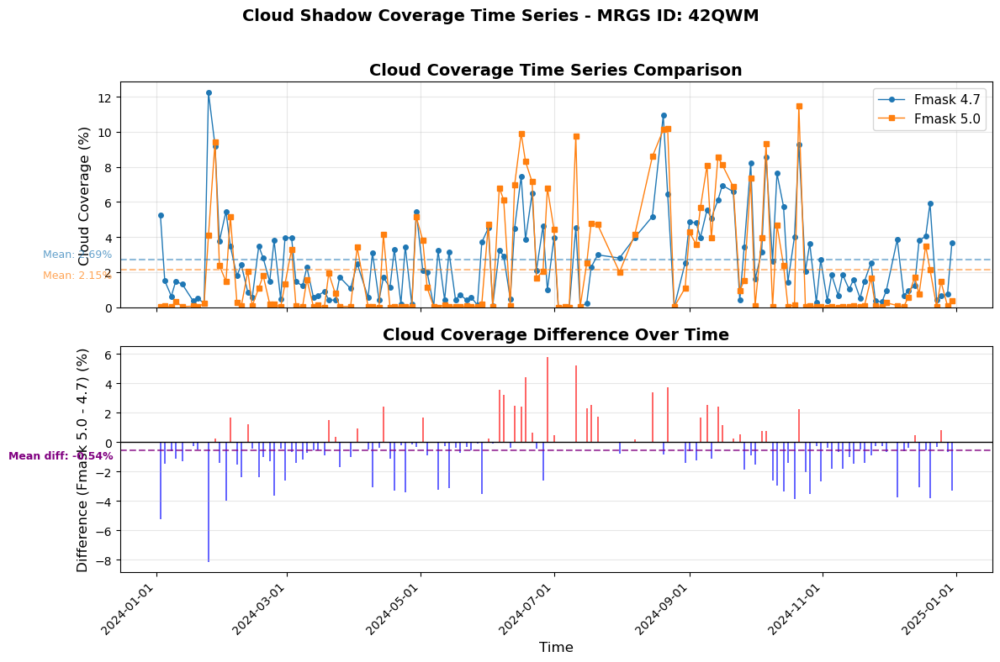

  ✓ Cloud Shadow coverage time series plotted (132 time steps)

[Step 4] Creating visualization for 42QWM...


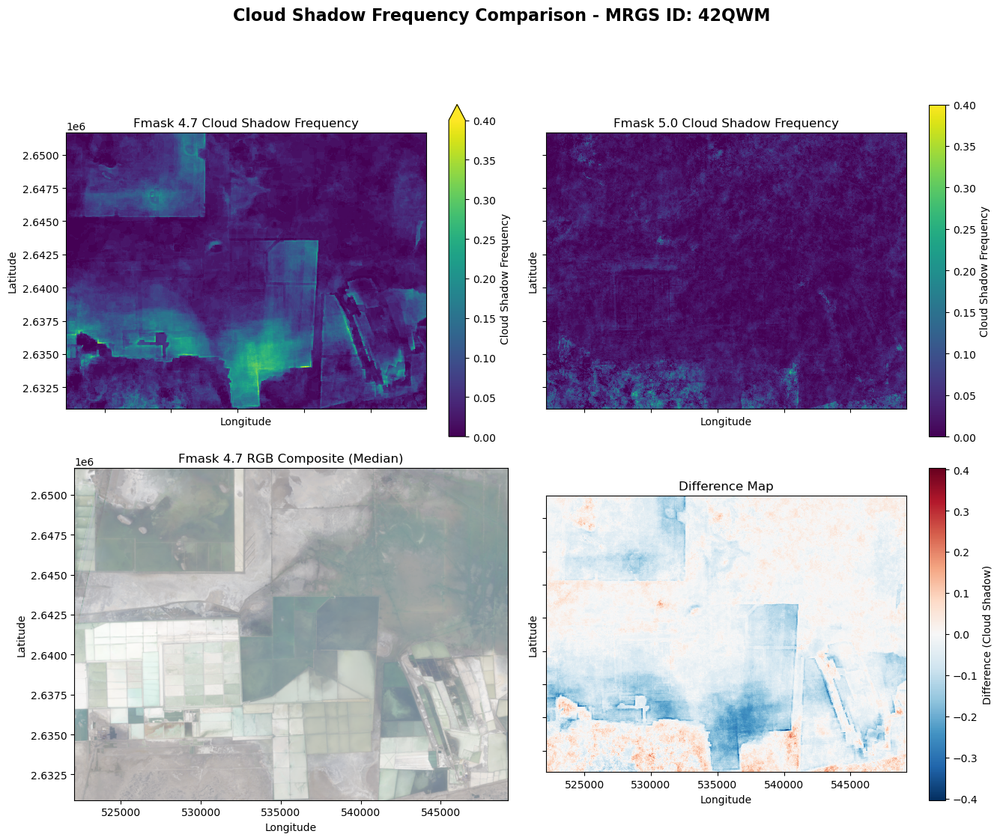

  ✓ Completed processing 42QWM

Batch processing complete!
  Successfully processed: 1
  Skipped: 0
  Errors: 0


--- Detailed Cloud Shadow Results for MRGS ID: 42QWM ---
Fmask 4.7 shadow frequency shape: (3660, 3660)
Fmask 5.0 shadow frequency shape: (3660, 3660)
Fmask 4.7 shadow frequency range: 0.000 to 0.473
Fmask 5.0 shadow frequency range: 0.000 to 0.344

Cloud shadow coverage time series summary:
  Mean Fmask 4.7 shadow coverage: 2.69%
  Mean Fmask 5.0 shadow coverage: 2.15%
  Mean difference (Fmask 5.0 - 4.7): -0.54%
  Time range: 2024-01-03 to 2024-12-30

First 5 rows of cloud shadow coverage DataFrame:
        time  fmask4_coverage  fmask5_coverage  difference
0 2024-01-03         5.260041         0.005400   -5.254640
1 2024-01-05         1.502175         0.055272   -1.446904
2 2024-01-08         0.627363         0.008608   -0.618754
3 2024-01-10         1.465529         0.325564   -1.139965
4 2024-01-13         1.312983         0.027075   -1.285908


In [12]:
# Section 9: Focused cloud shadow investigation for a single MRGS ID

# Choose plotting mode: "interactive" (qt5) or "static" (inline)
PLOT_MODE = "static"  # change to "interactive" if you want interactive windows

# Configuration
sat_id = 'S30'
# Choose a specific MRGS ID for detailed cloud shadow investigation
target_mrgs_id = '42QWM'

# S3 paths (MRGS ID will be automatically appended by batch_time_series_comparison)
s3_Fmask47 = f's3://hls-debug-output/Fmask4_outputs/TS/{sat_id}/'
s3_Fmask5 = f's3://hls-debug-output/Fmask5_outputs/TS/{sat_id}/'

# Optional: Define custom extent (x_min, x_max, y_min, y_max) to zoom into a specific region
# If None, auto_zoom will calculate extent from data bounds
# extent = None  # Set to None to use auto_zoom, or provide tuple (x_min, x_max, y_min, y_max)
extent = (522094.8, 549190.7, 2630893.0, 2651678.9)



single_shadow_results = batch_time_series_comparison(
    mrgs_id_list=[target_mrgs_id],  # Pass as a list for batch function
    bucket='hls-debug-output',
    fmask4_files=s3_Fmask47,
    fmask5_files=s3_Fmask5,
    output_dir='./outputs',
    min_valid_ratio=0.6,
    vmin=0.0,
    vmax=0.4,                 # narrower range is often useful for cloud shadow
    cmap='viridis',
    figsize=(15, 12),
    export=False,
    show_plot=True,
    auto_zoom=True,
    mask_value=2,             # 2 for cloud shadow
    extent=extent             # Custom extent (x_min, x_max, y_min, y_max) or None for auto
)

# Inspect detailed results for the chosen MRGS ID
if target_mrgs_id in single_shadow_results:
    result = single_shadow_results[target_mrgs_id]
    if result['status'] == 'success':
        print(f"\n--- Detailed Cloud Shadow Results for MRGS ID: {target_mrgs_id} ---")
        f4_freq = result['fmask4_frequency']
        f5_freq = result['fmask5_frequency']
        print(f"Fmask 4.7 shadow frequency shape: {f4_freq.shape}")
        print(f"Fmask 5.0 shadow frequency shape: {f5_freq.shape}")
        print(f"Fmask 4.7 shadow frequency range: {f4_freq.min().values:.3f} to {f4_freq.max().values:.3f}")
        print(f"Fmask 5.0 shadow frequency range: {f5_freq.min().values:.3f} to {f5_freq.max().values:.3f}")

        if result['cloud_coverage_df'] is not None:
            df = result['cloud_coverage_df']
            print("\nCloud shadow coverage time series summary:")
            print(f"  Mean Fmask 4.7 shadow coverage: {df['fmask4_coverage'].mean():.2f}%")
            print(f"  Mean Fmask 5.0 shadow coverage: {df['fmask5_coverage'].mean():.2f}%")
            print(f"  Mean difference (Fmask 5.0 - 4.7): {df['difference'].mean():.2f}%")
            print(f"  Time range: {df['time'].min().strftime('%Y-%m-%d')} to {df['time'].max().strftime('%Y-%m-%d')}")
            print("\nFirst 5 rows of cloud shadow coverage DataFrame:")
            print(df.head())
        else:
            print("\nNo cloud shadow coverage time series data available.")
    else:
        print(f"Processing for {target_mrgs_id} was {result['status']}: {result.get('reason', result.get('error', 'Unknown error'))}")
else:
    print(f"No results found for MRGS ID: {target_mrgs_id}")

# Note: If you want to apply a custom extent, set the 'extent' variable above
# before calling batch_time_series_comparison. The extent will be applied to all plot panels.
# Example: extent = (522094.8, 549190.7, 2630893.0, 2651678.9)
# 
# Alternatively, you can manually adjust the extent after plotting by accessing the figure:
# if target_mrgs_id in single_shadow_results and single_shadow_results[target_mrgs_id]['status'] == 'success':
#     fig = single_shadow_results[target_mrgs_id]['fig']
#     axes = single_shadow_results[target_mrgs_id]['axes']
#     for ax in axes:
#         if ax.get_visible():
#             ax.set_xlim(522094.8, 549190.7)
#             ax.set_ylim(2630893.0, 2651678.9)
#     plt.show()  # Re-display with updated extent
